# 细胞群落

In [1]:
from imp import reload
from IPython.display import display, Markdown, Latex
from tqdm import tqdm
import seaborn as sns
import math
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import numpy as np
from skimage import measure,data,color
from scipy.spatial.distance import cdist
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')



def set_style():
    sns.set_style('whitegrid')
    plt.rcParams['font.sans-serif'] = ['SimHei']
    plt.rcParams['axes.unicode_minus'] = False
    pd.options.display.max_columns = 300
    pd.options.display.max_rows = 1000
    # plt.rcParams['figure.dpi'] = 200
    sns.set_palette('muted')  # 调色板颜色温和
    sns.set_context("notebook", font_scale=1.2, rc={"lines.linewidth": 1})

set_style()

In [2]:
def plt_show(img_ndarray, figsize=(24,6), gray=True):
    """默认画灰度图"""
    plt.figure(figsize=figsize)
    plt.grid(False)
    if gray:
        plt.imshow(img_ndarray, 'gray')
    else:
        plt.imshow(img_ndarray)
    plt.show()
    
# 数据结构 imgs = [{"name": "title", "content": img, "type":"img"}]
def plt_series_show(imgs=[{},], lay_out=(1,2), figsize=(24,6)):
    """画序列图
    para:
        imgs:顺序展示的图像字典
        lay_out: 图像展示的顺序 默认画两张图
        figsize: 画板大小
    """
    
    def plt_show_gray(img, img_name):
        plt.title(img_name)
        plt.grid(False)
        plt.imshow(img, 'gray')
        
    def plt_plot(fig, title_name):
        plt.xlim([0, 256])
        plt.title(title_name)
        plt.plot(fig)
        
    plt.figure(figsize=figsize)
    for i, img_ in enumerate(imgs):
        plt.subplot(*lay_out, i+1)
        if img_["type"] == "img":
            plt_show_gray(img_["content"], img_["name"])
        elif img_["type"] == "fig":
            plt_plot(img_["content"], img_["name"])
        else:
            raise ValueError("img_[type]")
    plt.show

## 通道分析

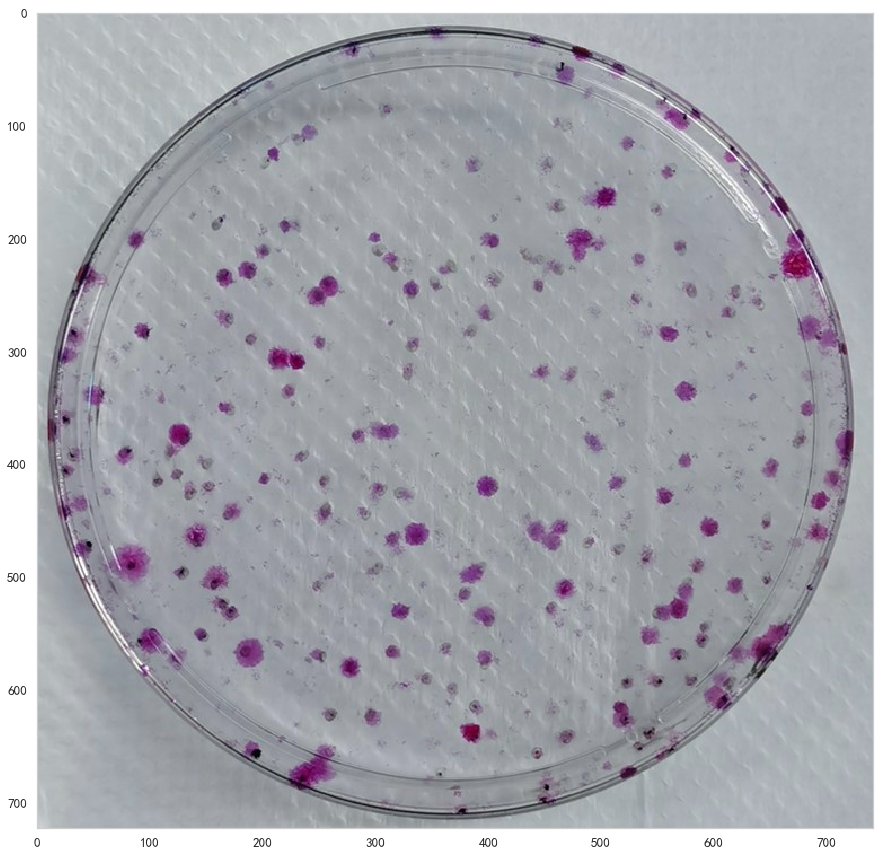

In [4]:
img_origin = cv2.imread('data/cells1/187-1.jpg')  
plt_show(img_origin, figsize=(15,15), gray=False)

### 通道颜色对比

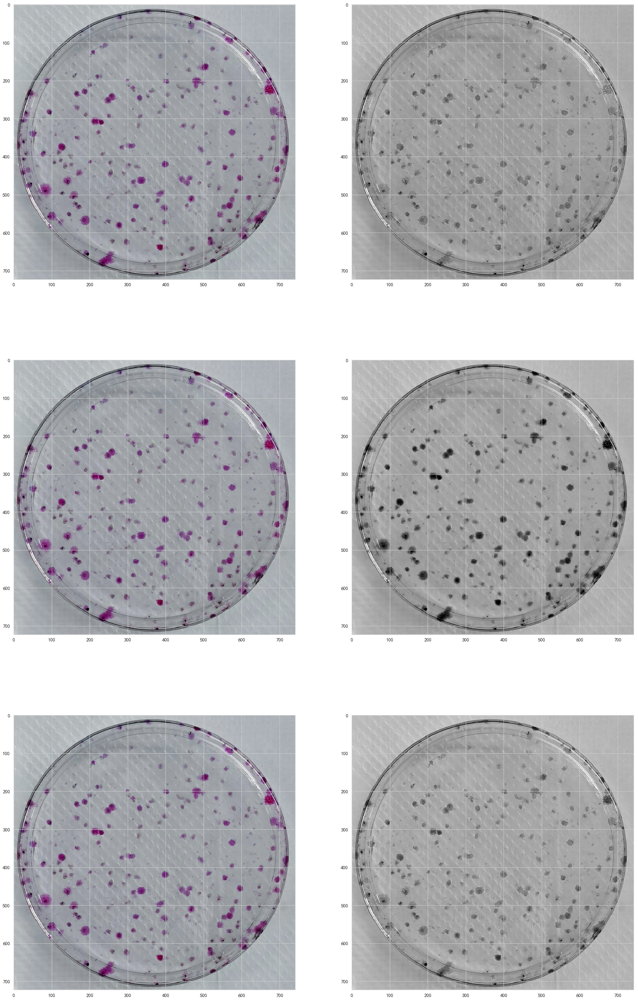

In [6]:
img = cv2.imread('data/cells1/187-1.jpg')
fig,ax = plt.subplots(3,2,figsize=(30,50))

# cv2默认为 BGR顺序，而其他软件一般使用RGB
ax[0][0].imshow(img)
ax[1][0].imshow(img)
ax[2][0].imshow(img)
img_b = img[:,:,0]
ax[0][1].imshow(img_b,'gray')

img_g = img[:,:,1]
ax[1,1].imshow(img_g,'gray')


img_r = img[:,:,2]
ax[2,1].imshow(img_r,'gray')


这张图的三个通道中，可以看出g通道的值整体高于其两通道

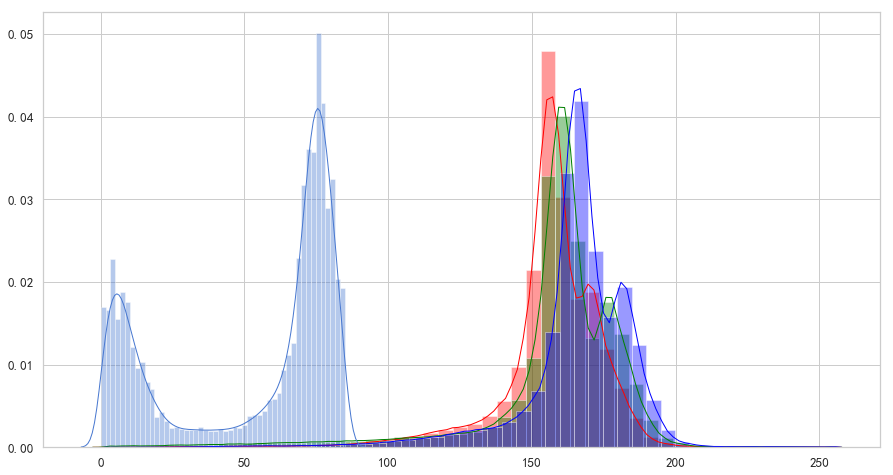

In [7]:
plt.figure(figsize=(15,8))

img_mean = (img[:,:,0]+img[:,:,1]+img[:,:,2])/3
sns.distplot(img[:,:,0].flatten(), color="R")
sns.distplot(img[:,:,1].flatten(),color="G")
sns.distplot(img[:,:,2].flatten(), color="B")
sns.distplot(img_mean.flatten())
plt.show()

由三个通道上每个像素值的分布可以发现，所有像素点的三个通道（R，G，B）的值value都主要集中在（100，200），而且截断性很明显。

<span class="mark">三通道均值图当中，有一个明显的峰说明什么？</span>

### 通道处理对比

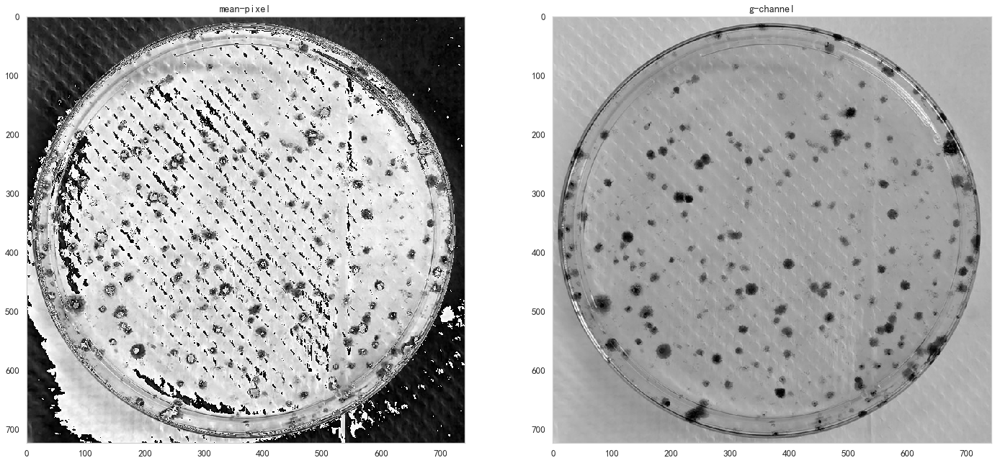

In [8]:
# 数据结构 imgs = [{"name": "title", "content": img, "type":"img"}]
plt_series_show(imgs=[{"name": "mean-pixel", "content": img_mean, "type":"img"},
                     {"name": "g-channel", "content": img[:,:,1], "type":"img"}], 
                lay_out=(1,2), figsize=(24,12))


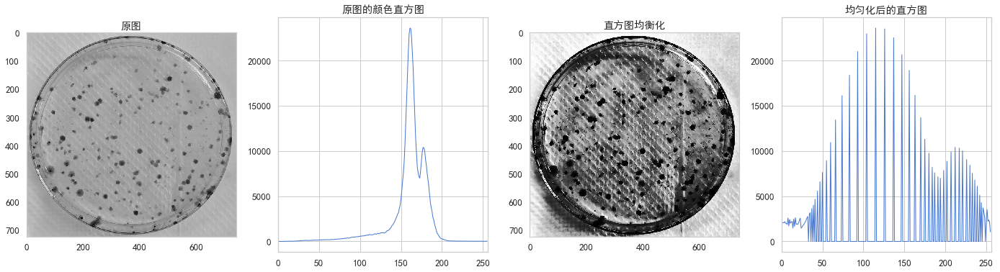

In [9]:
# 1 原图
img_gray = cv2.imread('data/cells1/187-1.jpg', 0)
# 2 原图的颜色直方图
hist_1 = cv2.calcHist([img_gray], [0], None, [256], [0, 256])

# 3 直方图均衡化
img_2 = cv2.equalizeHist(img_gray)
# 4 均匀化后的图
hist_2 = cv2.calcHist([img_2], [0], None, [256], [0, 256])

imgs = [{"name": "原图", "content": img_gray, "type": "img"},
       {"name": "原图的颜色直方图", "content": hist_1, "type":"fig"},
       {"name": "直方图均衡化", "content": img_2, "type":"img"},
       {"name": "均匀化后的直方图", "content": hist_2, "type":"fig"}]

plt_series_show(imgs, lay_out=(1,4), figsize=(24,6))

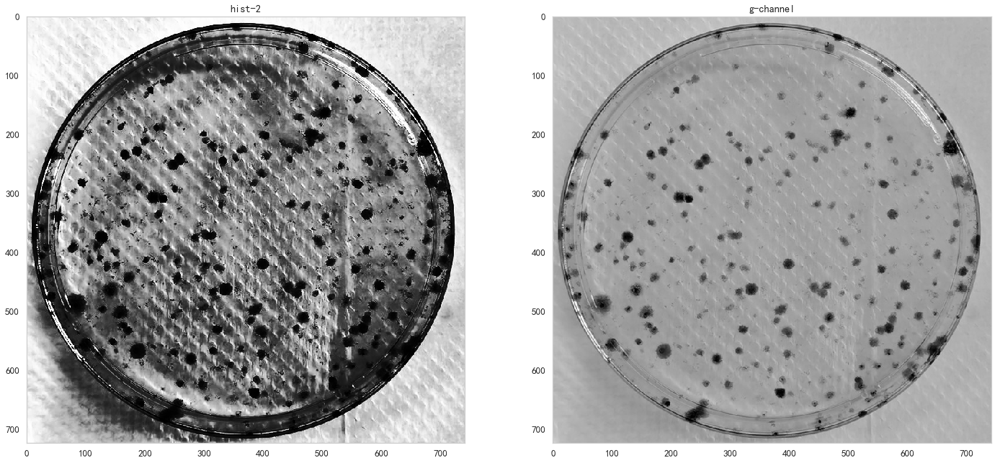

In [10]:
plt_series_show(imgs=[{"name": "hist-2", "content": img_2, "type":"img"},
                     {"name": "g-channel", "content": img[:,:,1], "type":"img"}], 
                lay_out=(1,2), figsize=(24,12))

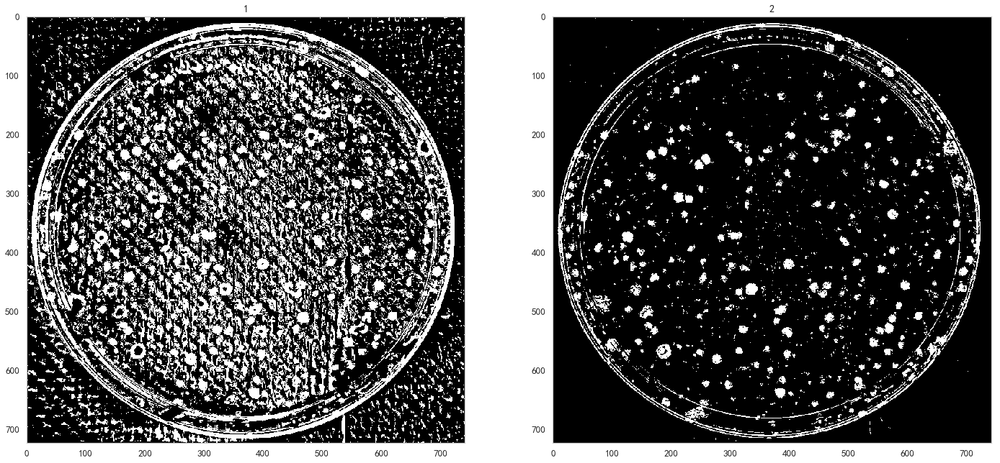

In [11]:
img_thresh_hist = cv2.adaptiveThreshold(
    img_2, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 10)

img_thresh_g = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 10)

plt_series_show(imgs=[{"name": "1", "content": img_thresh_hist, "type":"img"},
                     {"name": "2", "content": img_thresh_g, "type":"img"}], 
                lay_out=(1,2), figsize=(24,12))

**结论：**

通道分析表明，不做像素均处理，不做直方图均衡化处理，直接采用g通道 作后续的二值化处理，更容易分离细胞群落

### 自适应阈值参数选择

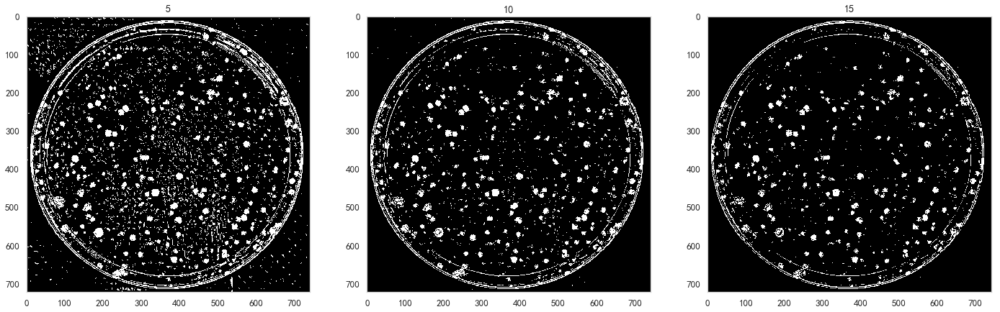

In [12]:
img_thresh_1 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 5)

img_thresh_2 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 10)

img_thresh_3 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 15)

plt_series_show(imgs=[{"name": "5", "content": img_thresh_1, "type":"img"},
                     {"name": "10", "content": img_thresh_2, "type":"img"},
                      {"name": "15", "content": img_thresh_3, "type":"img"}], 
                lay_out=(1,3), figsize=(24,12))

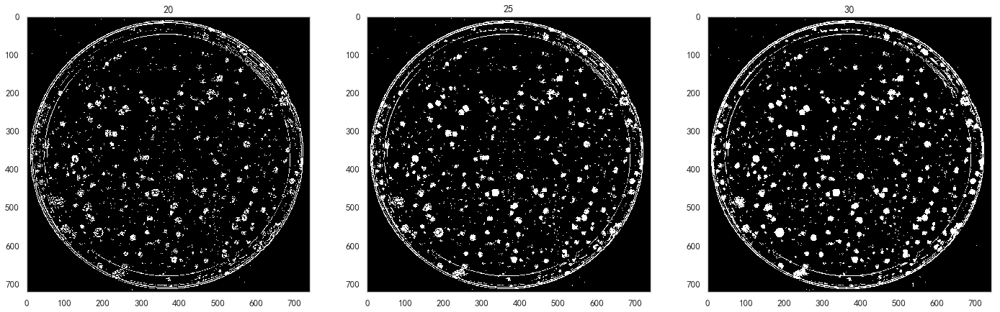

In [13]:
img_thresh_4 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 15, 10)

img_thresh_5 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 10)

img_thresh_6 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 35, 10)

plt_series_show(imgs=[{"name": "20", "content": img_thresh_4, "type":"img"},
                     {"name": "25", "content": img_thresh_5, "type":"img"},
                      {"name": "30", "content": img_thresh_6, "type":"img"}], 
                lay_out=(1,3), figsize=(24,12))

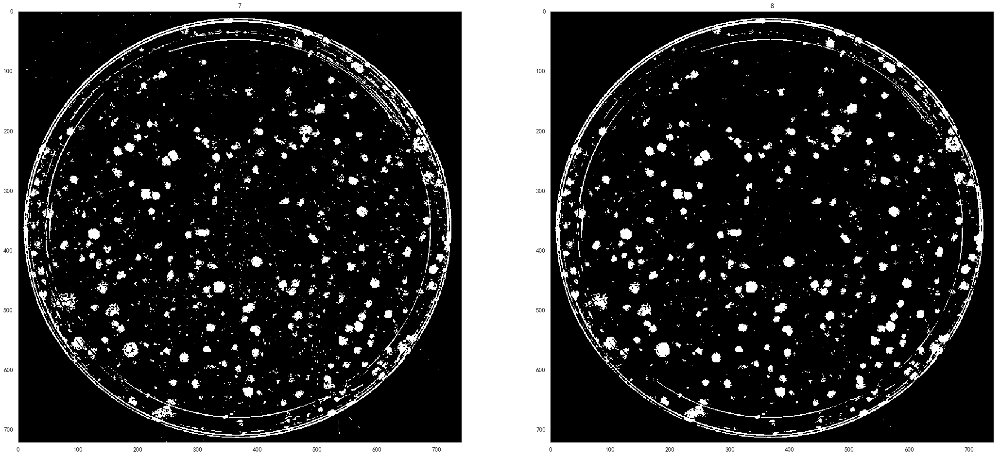

In [14]:
img_thresh_7 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 10)

img_thresh_8 = cv2.adaptiveThreshold(
    img[:,:,1], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 35, 15)

plt_series_show(imgs=[{"name": "7", "content": img_thresh_7, "type":"img"},
                     {"name": "8", "content": img_thresh_8, "type":"img"}], 
                lay_out=(1,2), figsize=(36,18))

(723, 742, 3)


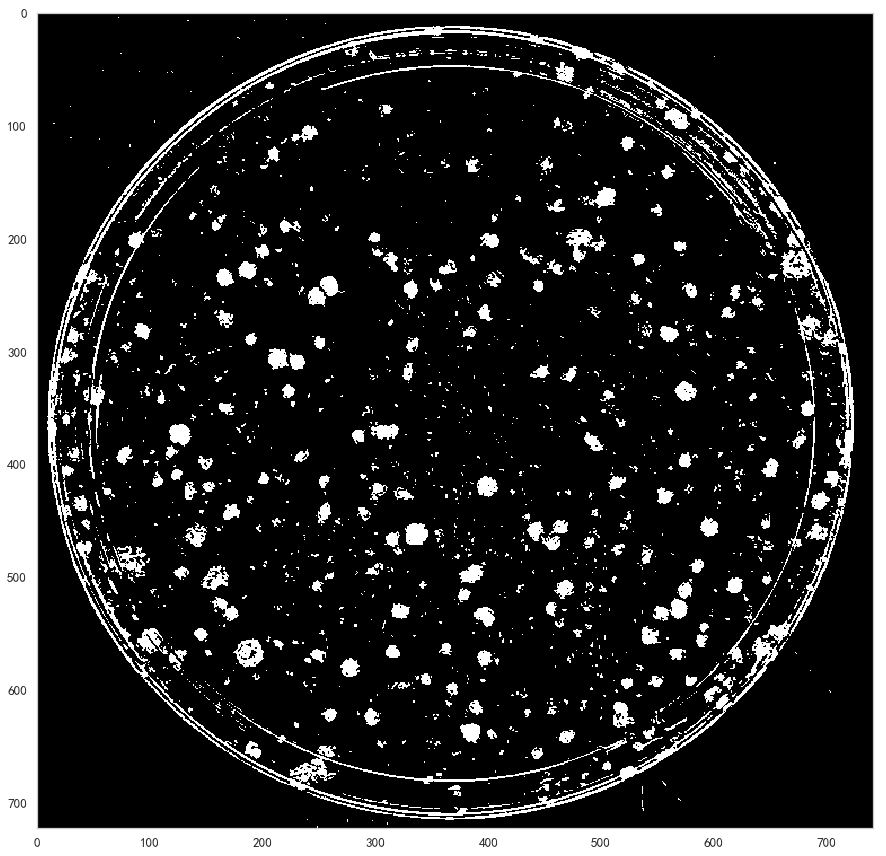

In [15]:
img_origin = cv2.imread('data/cells1/187-1.jpg');print(img.shape)

img_g = img_origin[:,:,1]
img_thresh = cv2.adaptiveThreshold(
    img_g, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 25, 10)


plt_show(img_thresh, figsize=(20,15))  # 这个函数默认显示灰色图

(723, 742, 3)


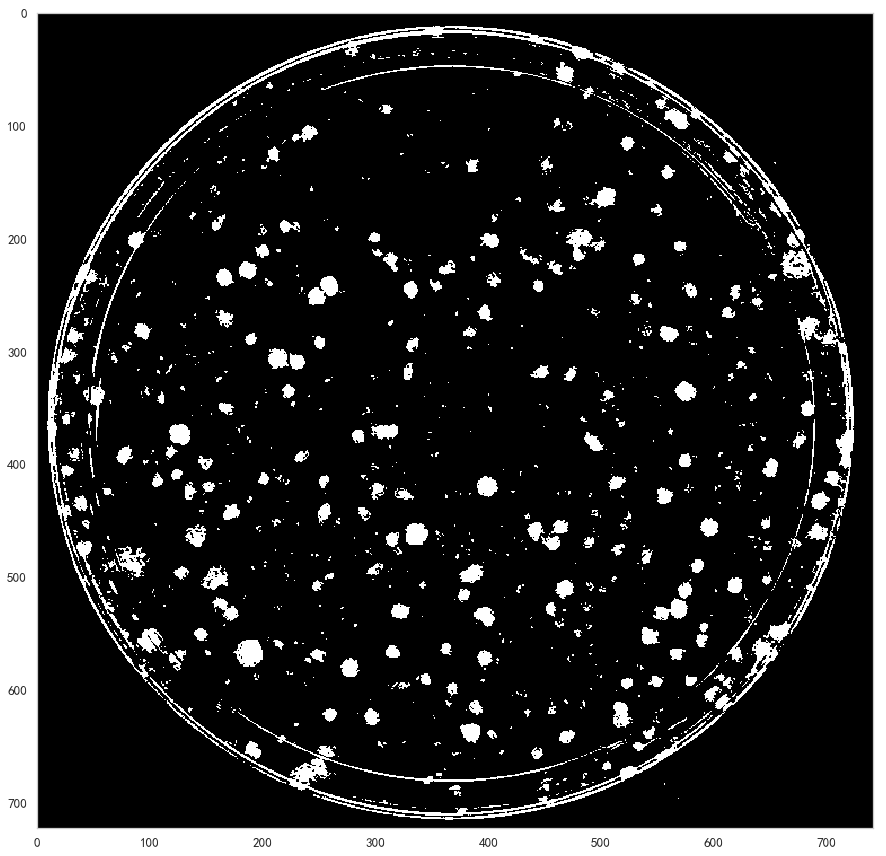

In [16]:
def img_thresh(gray_img):
    """在内部写好 参数（35， 15）"""
    img_bin = cv2.adaptiveThreshold(
        img_g, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 35, 15)
    return img_bin

img_origin = cv2.imread('data/cells1/187-1.jpg');print(img.shape)
img_g = img_origin[:,:,1]
img_bin = img_thresh(img_g)

plt_show(img_bin, figsize=(20,15))

### 对比阈值化和canny边缘检测在寻找contuours上是效果
canny边缘检测效果比直接使用阈值检测应该有更好的去噪效果,但是也有更多的信息损失

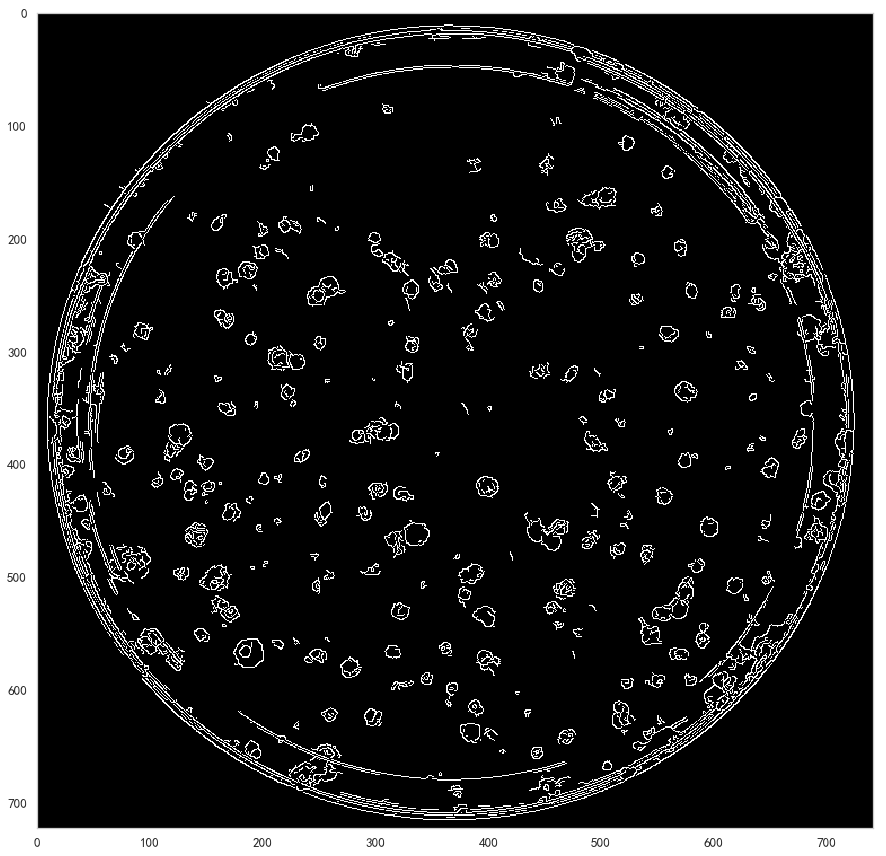

In [17]:
cany_img = cv2.Canny(img_origin, 80, 200)
plt_show(cany_img, figsize=(20,15))

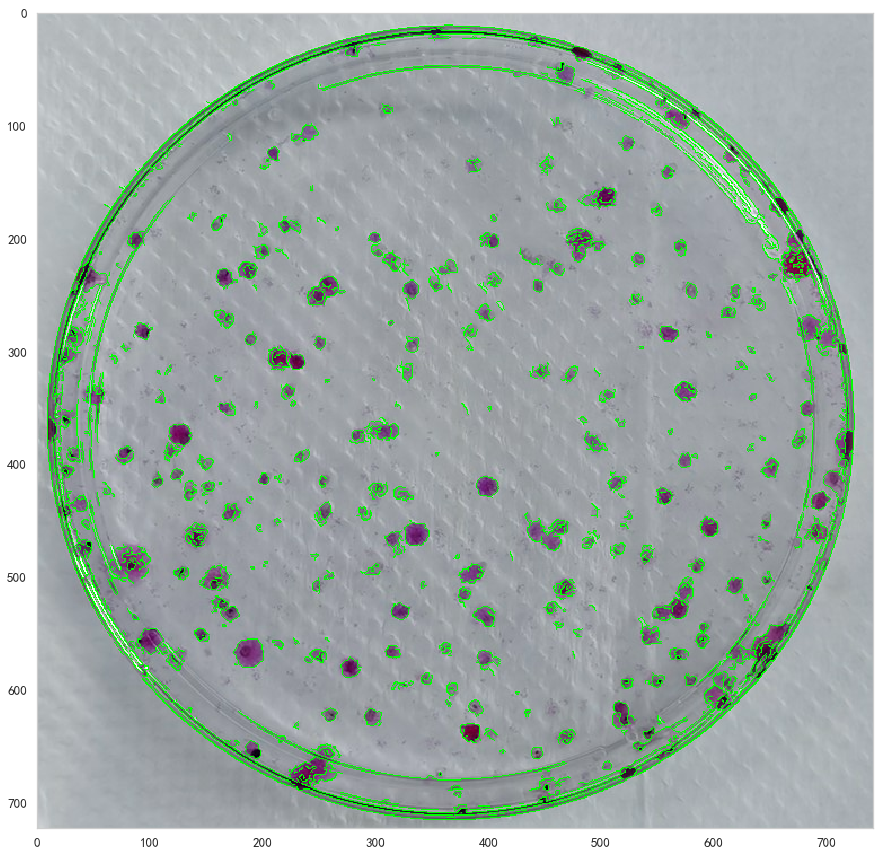

In [18]:
img_draw = img_origin.copy()
contours_origin, hierarchy = cv2.findContours(cany_img, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
res = cv2.drawContours(img_draw, contours_origin, -1, (0, 255, 0), 1)

plt_show(res, figsize=(20,15))

**参数：**

在自适应阈值的选择上，观察对比后选择 （35，15）这组参数；使用自适应阈值和canny边缘检测为后续轮廓检测提供二值图时，直观上效果没有明显的差异

## 图像滤波
对图像进行模糊操作，以减少图像中的细微差异。

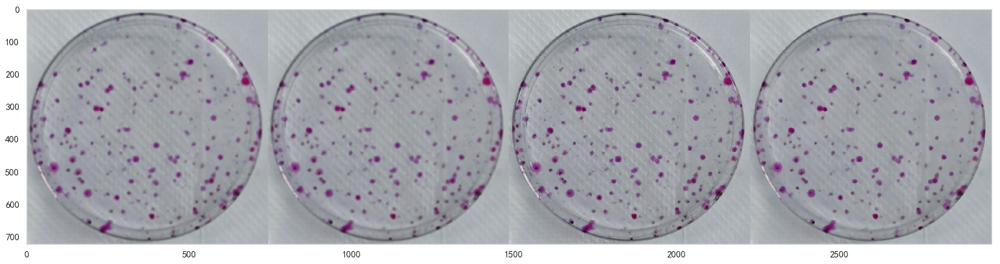

In [19]:
img_origin = cv2.imread('data/cells1/187-1.jpg')

# 均值滤波 平均卷积操作
blur = cv2.blur(img_origin, (7, 7))

# 方框滤波 基本和均值一样，可以选择归一化
box = cv2.boxFilter(img_origin, -1, (7, 7), normalize=True)

# 高斯滤波 高斯模糊的卷积核里的数值是满足高斯分布，相当于更重视中间的
aussian = cv2.GaussianBlur(img_origin, (7, 7), 1)

# 中值滤波 相当于用中值代替
median = cv2.medianBlur(img_origin, 7)

res = np.hstack((blur, box, aussian, median))

plt_show(res, gray=False)

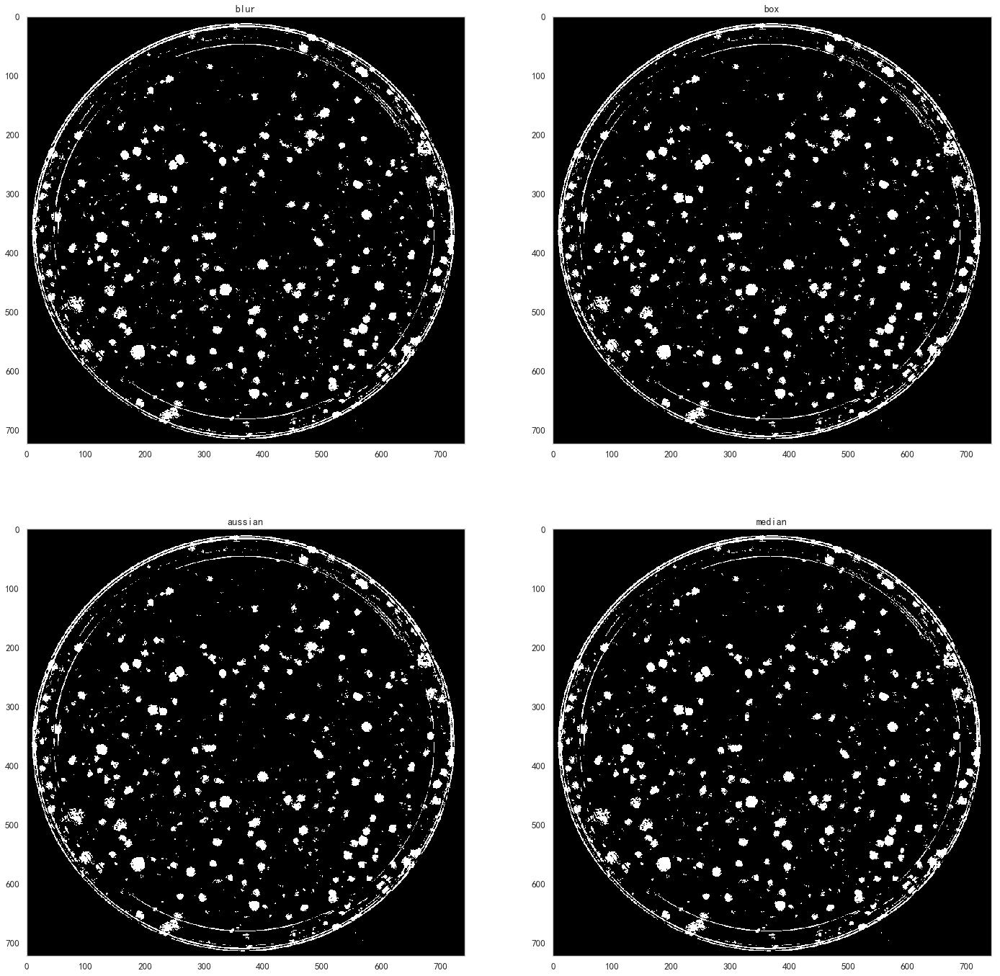

In [20]:
filted_imgs = [blur, box, aussian, median]
img_bins = []
for img in filted_imgs:
    filted_img_bin = img_thresh(img[:,:,1])
    img_bins.append(filted_img_bin)
    
plt_series_show(imgs=[{"name": "blur", "content": img_bins[0], "type":"img"},
                     {"name": "box", "content": img_bins[1], "type":"img"},
                      {"name": "aussian", "content": img_bins[2], "type":"img"},
                      {"name": "median", "content": img_bins[3], "type":"img"}], 
                lay_out=(2,2), figsize=(24,24))

**结论：**

滤波操作，几乎看不出来 在这张图像处理过程中使用滤波方法的作用。

## 细胞群落轮廓查找
### 轮廓特征分析

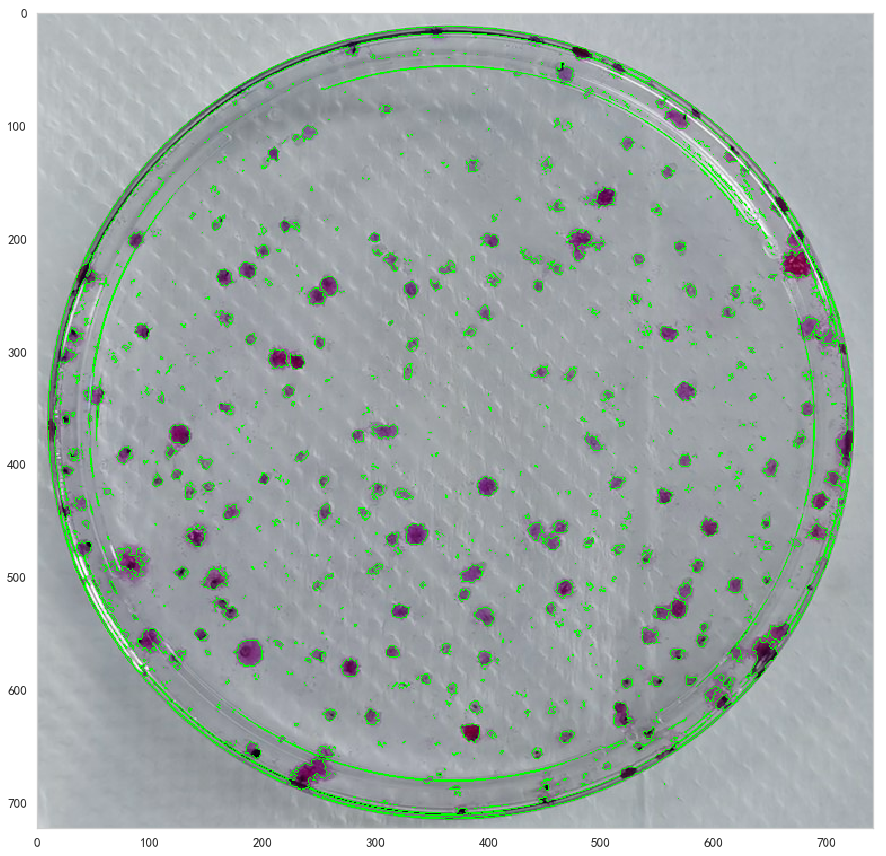

In [21]:
# 画出原始轮廓 contours_origin
img_origin = cv2.imread('data/cells1/187-1.jpg')
img_g = img_origin[:,:,1]
img_thresh_bin = img_thresh(img_g)

contours_origin, hierarchy = cv2.findContours(img_thresh_bin, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
img_draw = img_origin.copy()
res = cv2.drawContours(img_draw, contours_origin, -1, (0, 255, 0), 1)

plt_show(res, figsize=(20,15))

In [22]:
# 轮廓分析
def cont_df_analysis(contours):
    
    print('轮廓总个数:', np.array(contours).shape[0])
    cont_arclength = []  # 轮廓周长
    hull = []  # 轮廓凸包
    hull_arclength = []  # 凸包周长
    cnt_boundingrect_w = []
    cnt_boundingrect_h = []
    for i in range(len(contours)):
        hull.append(cv2.convexHull(contours[i], True))  # 轮廓凸包
        cont_arclength.append(cv2.arcLength(contours[i], True))  # 轮廓周长
        hull_arclength.append(cv2.arcLength(hull[i], True))  # 轮廓凸包周长
        x,y, w, h = cv2.boundingRect(contours[i])
        cnt_boundingrect_w.append(w)
        cnt_boundingrect_h.append(h)
    cont_area = []
    hull_area = []
    for i in range(len(contours)):
        cont_area.append(cv2.contourArea(contours[i]))
        hull_area.append(cv2.contourArea(hull[i]))

    df_area = pd.DataFrame({
        'area': cont_area,
        'area_hull': hull_area,
        'arclength': cont_arclength,
        'arclength_hull': hull_arclength,
        'rect_w': cnt_boundingrect_w,
        'rect_h': cnt_boundingrect_h,
    })

    df_area['r1'] = df_area['area'] / df_area['arclength']  # 轮廓面积 / 轮廓周长 = 面积周长比
    df_area['r2'] = df_area['arclength'] / df_area['arclength_hull']
#     df_area['r3'] = df_area['area'] / df_area['area_hull']  # 
#     df_area['d1'] = df_area['area_hull'] - df_area['area']  # 凸包的面积 - 轮廓的面积
    df_area = df_area[df_area['area'] > 10]  # 筛选出面积大于100的轮廓
    df_area = df_area[df_area['area'] < 2000]
    print("根据轮廓面积初步过滤后 轮廓个数为:",  len(df_area))
    return df_area

df_area_filtered = cont_df_analysis(contours_origin)
df_area_filtered.describe()

轮廓总个数: 1173
根据轮廓面积初步过滤后 轮廓个数为: 214


,area,area_hull,arclength,arclength_hull,rect_w,rect_h,r1,r2
count,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000
mean,86.593458,133.514019,53.898712,44.909520,15.079439,14.967290,1.597862,1.187984
std,76.249009,200.295819,45.873264,39.312557,15.906365,12.389374,0.846476,0.153887
min,10.500000,11.000000,13.071068,12.892922,4.000000,4.000000,0.152731,1.013817
25%,34.500000,48.750000,31.642135,29.264307,10.000000,10.000000,0.908597,1.082634
50%,64.750000,87.500000,44.506096,36.378718,12.000000,12.000000,1.547434,1.144204
75%,115.000000,147.250000,56.759144,47.111518,16.000000,16.000000,2.125140,1.246993
max,453.000000,2237.000000,436.994948,408.632823,203.000000,129.000000,5.074986,2.066170


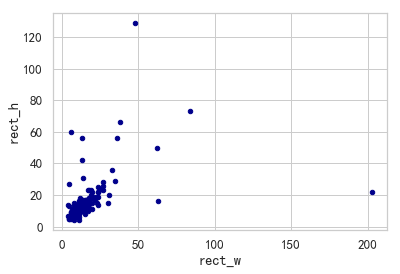

In [23]:
df_area_filtered.plot.scatter(x='rect_w', y='rect_h', c='DarkBlue')

从分布上看 群落轮廓外正外接矩形的宽w集中在5-30， 高h集中在5-30，所以判别标准（0<w<30，0<h<30） 

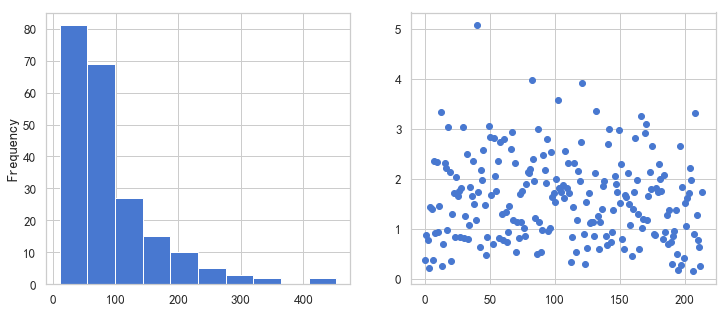

In [24]:
plt.figure(figsize=(12,5))
plt.subplot(121)
ax1 = df_area_filtered.area.plot(kind="hist")
plt.subplot(122)
x_range = np.arange(len(df_area_filtered.r1))
y = df_area_filtered.r1
plt.scatter(x_range, y)


In [ ]:
# area_leng = df_area_filtered.area
# area_leng.sort_values().head(50)

轮廓面积分布大致在500以内， 轮廓面积和周长的比在绝大部分0.5 以上
>由上数据分析，是细胞轮廓的必要条件有：
(1）面积area:   15<area<500; (2)正外接矩形宽高（0<w<30,0<h<30); (3)面积周长比大于0.5

### 检测标准系列一：矩形  
使用轮廓外接矩形来判断 合适的轮廓，同时记录轮廓的img_mask_bin图辅助分析

In [25]:
def affirm_population(img_origin, contours, mim_area=20, max_area=500):
    # 1 img_mask_bin 画板
    h, w, _ = img_origin.shape
    img_mask_bin = np.zeros((h, w))
   
    population_cnt = []
    for i in range(len(contours)):
        cnt = contours[i]
        # 2 过滤掉面积不对的轮廓
        if  mim_area < cv2.contourArea(cnt) < max_area:  
            x,y,w,h = cv2.boundingRect(cnt)
            if w < 30 and h < 30: 
                population_cnt.append(cnt)
                # 把轮廓画到二值图上
                cv2.drawContours(img_mask_bin, [cnt], -1, (255, 255, 255), cv2.FILLED)
    return population_cnt, img_mask_bin

In [26]:
def affirm_population_p(img_origin, contours, mim_area=20, max_area=500):
    # 1 img_mask_bin 画板
    h, w, _ = img_origin.shape
    img_mask_bin = np.zeros((h, w))
   
    population_cnt = []
    for i in range(len(contours)):
        cnt = contours[i]
         # 2  过滤掉面积不对的轮廓
        if  mim_area < cv2.contourArea(cnt) < max_area:  
            x,y,w,h = cv2.boundingRect(cnt)
            if w < 30 and h < 30:
                # 3 利用面积周长比 过滤
                cnt_area = cv2.contourArea(cnt)
                cnt_length = cv2.arcLength(cnt,False)
                cnt_length_area =  cnt_area /cnt_length
                if cnt_length_area > 0.5: # 过滤掉 长条形的轮廓
                    population_cnt.append(cnt)
                    cv2.drawContours(img_mask_bin, [cnt], -1, (255, 255, 255), cv2.FILLED)
    return population_cnt, img_mask_bin

In [ ]:
# 对比两种判断方法的效果
img_origin = cv2.imread('data/Cell_population/187-1.jpg')

population_contours, img_map_bin = affirm_population(img_origin, contours_origin)
print(len(population_contours))

kernel_contours_p, img_map_bin = affirm_population_p(img_origin, contours_origin)
print(len(kernel_contours_p))



In [ ]:
# 原轮廓和过后的轮廓
img_origin = cv2.imread('data/Cell_population/187-1.jpg')
draw_origin_cnts = img_origin.copy()
draw_filtered_cnts = img_origin.copy()
population_contours, img_map_bin = affirm_population_p(img_origin, contours_origin)
print('检测到细胞个数为：', len(population_contours))

res_origin_cnts = cv2.drawContours(draw_origin_cnts, contours_origin, -1, (0, 255, 155), 1)
res_filtered_cnts = cv2.drawContours(draw_filtered_cnts, population_contours, -1, (0, 255, 0), 1)


plt_series_show(imgs=[{"name": "contours_origin", "content": res_origin_cnts, "type":"img"},
                     {"name": "res_filtered_cnts", "content": res_filtered_cnts, "type":"img"}], 
                lay_out=(2,1), figsize=(15,30))

**制定基于二值化的分割标准和检测类函数**

In [27]:
class CellPopulationTresh:
    
    def find_population(self, img_path):
        img_origin = cv2.imread(img_path)
        img_source = img_origin.copy()
        contours_origin = self.get_origin_cnts(img_origin)
        popu_contours = self.affirm_contours(img_origin, contours_origin)
        print('细胞个数为:%d' % len(popu_contours))
        img_source = cv2.drawContours(img_source, popu_contours, -1, (0, 255, 155), 1)
        plt_show(img_source, figsize=(20, 15))
    
    def count(self, img_path, draw=True):
        img_origin = cv2.imread(img_path)
        img_source = img_origin.copy()
        contours_origin = self.get_origin_cnts(img_origin)
        popu_contours = self.affirm_contours(img_origin, contours_origin)
        print('细胞个数为:%d' % len(popu_contours))
        if draw:
            for i, cnt in enumerate(popu_contours):
                try:
                    M = cv2.moments(cnt)
                    cx = int(M['m10'] / M['m00'])
                    cy = int(M['m01'] / M['m00'])
                    cv2.circle(img_source, (cx, cy), 2, (0, 255, 0), 1)
                    cv2.putText(img_source, str(i + 1), (cx + 5, cy + 5),
                                cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)

                except:
                    print('missing %d' %i)
                    continue

            plt_show(img_source, figsize=(20, 15))
    
    def img_thresh(self, gray_img):
        """在内部写好 参数（35， 15）"""
        img_bin = cv2.adaptiveThreshold(
            gray_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 35, 15)
        return img_bin
    
    def get_origin_cnts(self, img_soruce):
        img_g = img_soruce[:,:,1]
        img_thresh_bin = self.img_thresh(img_g)
        contours_origin, hierarchy = cv2.findContours(
            img_thresh_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        return contours_origin
    
    def affirm_contours(self, img_origin, contours):
        population_cnt, img_mask_bin = self._creterions(img_origin, contours)
        return population_cnt
    
    def _creterions(self, img_origin, contours, mim_area=15, max_area=20000):
        """后续修改的时候，直接优化这个轮廓判别函数"""
         # 1 img_mask_bin 画板
        h, w, _ = img_origin.shape
        img_mask_bin = np.zeros((h, w))

        population_cnt = []
        for i in range(len(contours)):
            cnt = contours[i]
             # 2  过滤掉面积不对的轮廓
            if  mim_area < cv2.contourArea(cnt) < max_area:  
                x,y,w,h = cv2.boundingRect(cnt)
                if w < 100 and h < 100:
                    # 3 利用面积周长比 过滤
                    cnt_area = cv2.contourArea(cnt)
                    cnt_length = cv2.arcLength(cnt,False)
                    cnt_length_area =  cnt_area /cnt_length
                    if cnt_length_area > 1: # 过滤掉 长条形的轮廓
                        population_cnt.append(cnt)
                        cv2.drawContours(img_mask_bin, [cnt], -1, (255, 255, 255), cv2.FILLED)
        return population_cnt, img_mask_bin


细胞个数为:152


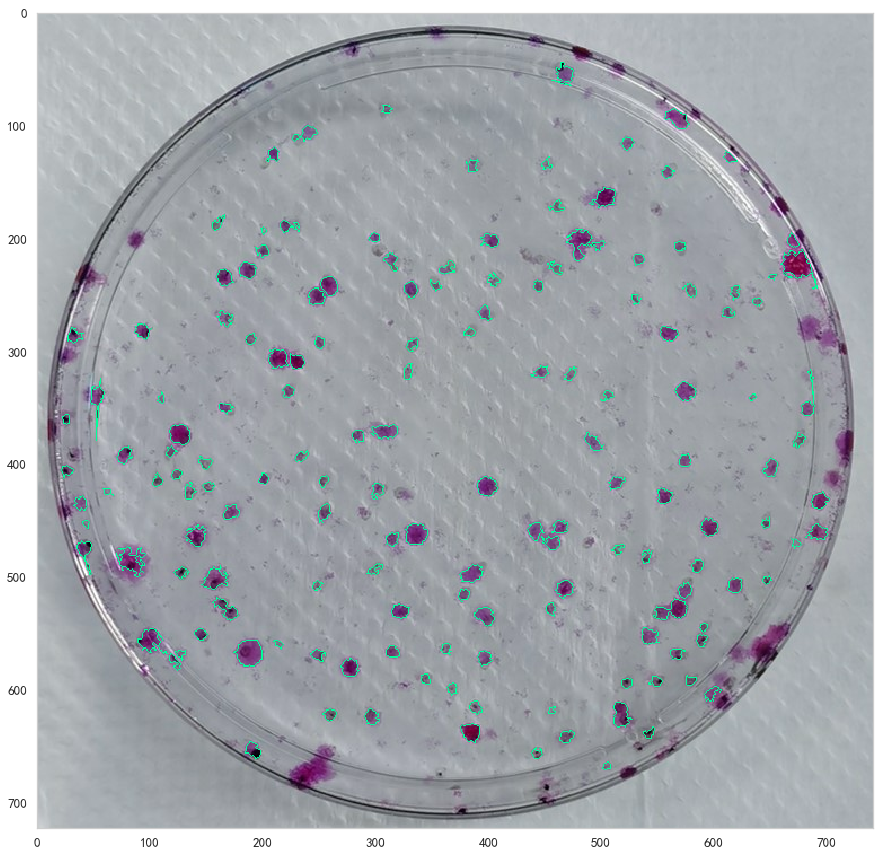

细胞个数为:224


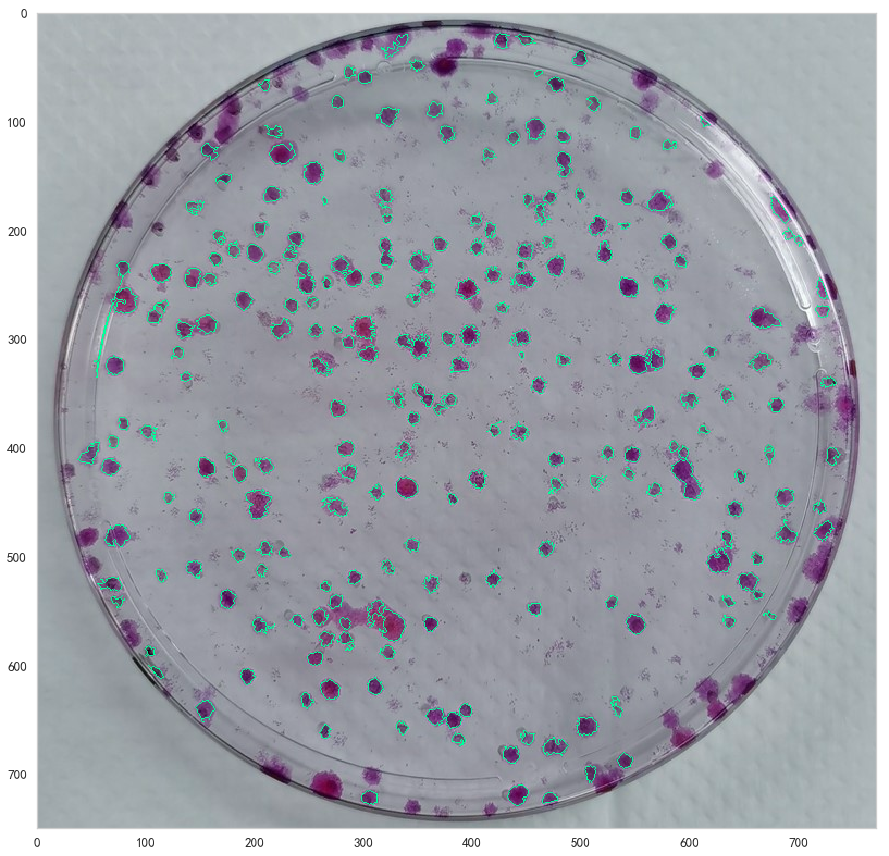

细胞个数为:302


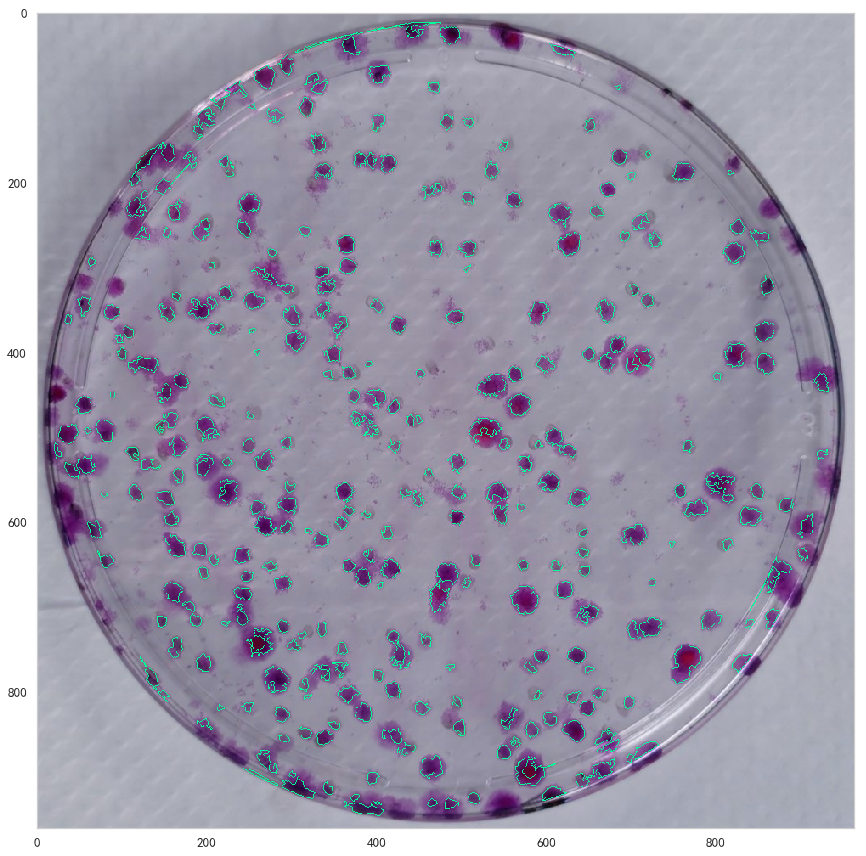

细胞个数为:294


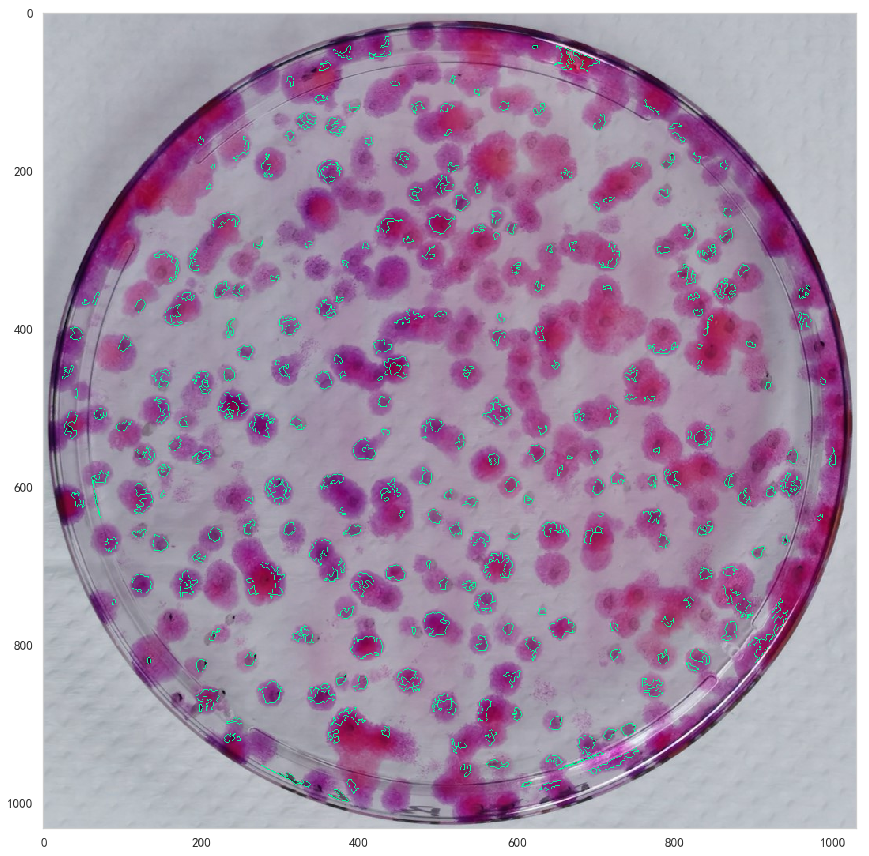

In [29]:
couter = CellPopulationTresh()
couter.find_population('data/cells1/187-1.jpg')

couter.find_population('data/cells1/296-1.jpg')

couter.find_population('data/cells1/308-1.jpg')

couter.find_population('data/cells1/313-1.jpg')

**由上输出可见，对于生长变化着的群落，一套规则难以满足准确计算的目的**

### 检测标准系列二：圆

In [30]:
def find_population(draw_on_img, contours, mim_area=20, max_area=500):
   
    population_cnt = []
    for i in range(len(contours)):
        cnt = contours[i]
        # 1 过滤掉面积不对的轮廓
        if  mim_area < cv2.contourArea(cnt) < max_area:  
            (x, y), radius = cv2.minEnclosingCircle(cnt)
            center = (int(x), int(y))
            radius = int(radius)
            if radius <= 25:
                # 把这个轮廓的外接圆画出来
                cv2.circle(draw_on_img, center, radius, (0, 255, 255), 1) # 画圆...
                cv2.circle(draw_on_img, center, 1, (255, 255, 0), 1)  # ...画圆心

                cv2.drawContours(draw_on_img, cnt, -1, (0, 255, 0), 1)
                population_cnt.append(cnt)
            
    plt_show(draw_on_img, figsize=(20,15), gray=False)
                
    return population_cnt


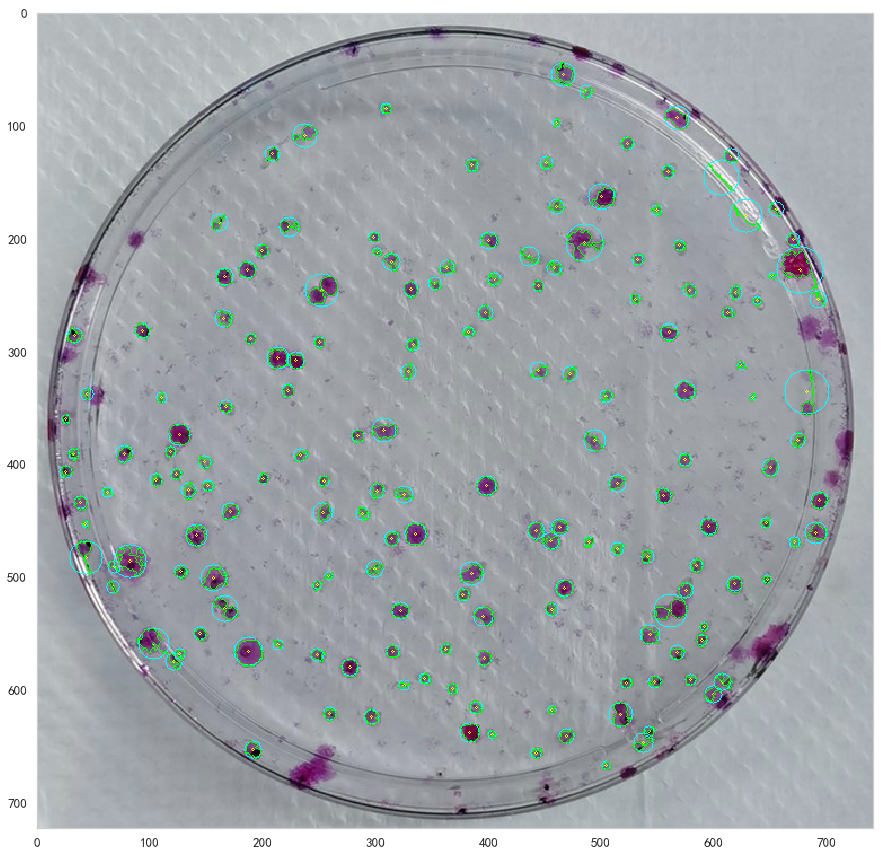

In [31]:
img_origin = cv2.imread('data/cells1/187-1.jpg')
img_g = img_origin[:,:,1]
img_thresh_bin = img_thresh(img_g)
contours_origin, hierarchy = cv2.findContours(img_thresh_bin, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
img_draw = img_origin.copy()

population_cnts = find_population(img_draw, contours_origin, mim_area=20, max_area=500)

**图像上隐含的信息有：**1）像素点的坐标信息，2）RGB颜色信息，3）HSV色彩信息，4）集合形状信息

**类脑算法启发点：** 看到一个圆，要我们寻找圆心，我会本能地往中间看，猜测圆心的大致位置。我们目测，是在抽取预设结论。（经验信息帮我们形成预设结论）

`好的特征`： 一些稳定不变的特征；细胞群落在生长过程中它的形状和大小会不断变化，所以群落轮廓的外接圆直径这个特征，对我们来说不是一个好的特征。而群落的颜色这个特征相对稳定一些，变化不剧烈，所以对我们检测而言，它是一个好的特征。

**圆形规则没有，矩形规则效果好**

### 检测标准系列三：颜色空间

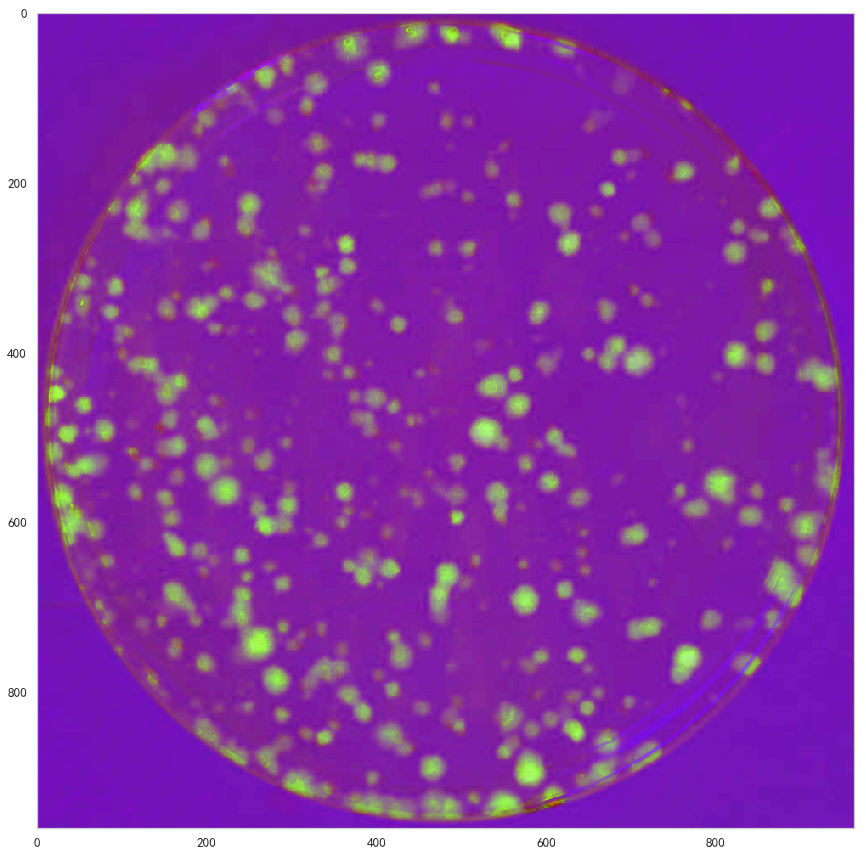

In [32]:
img_origin = cv2.imread('data/cells1/308-1.jpg')
hsv = cv2.cvtColor(img_origin, cv2.COLOR_RGB2HSV)
plt_show(hsv, figsize=(20,15), gray=False)

In [ ]:
# img_origin = cv2.imread('data/Cell_population/296-1.jpg')
# hsv = cv2.cvtColor(img_origin, cv2.COLOR_RGB2HSV)
# plt_show(hsv, figsize=(20,15), gray=False)

# img_origin = cv2.imread('data/Cell_population/308-1.jpg')
# hsv = cv2.cvtColor(img_origin, cv2.COLOR_RGB2HSV)
# plt_show(hsv, figsize=(20,15), gray=False)

# img_origin = cv2.imread('data/Cell_population/313-1.jpg')
# hsv = cv2.cvtColor(img_origin, cv2.COLOR_RGB2HSV)
# plt_show(hsv, figsize=(20,15), gray=False)

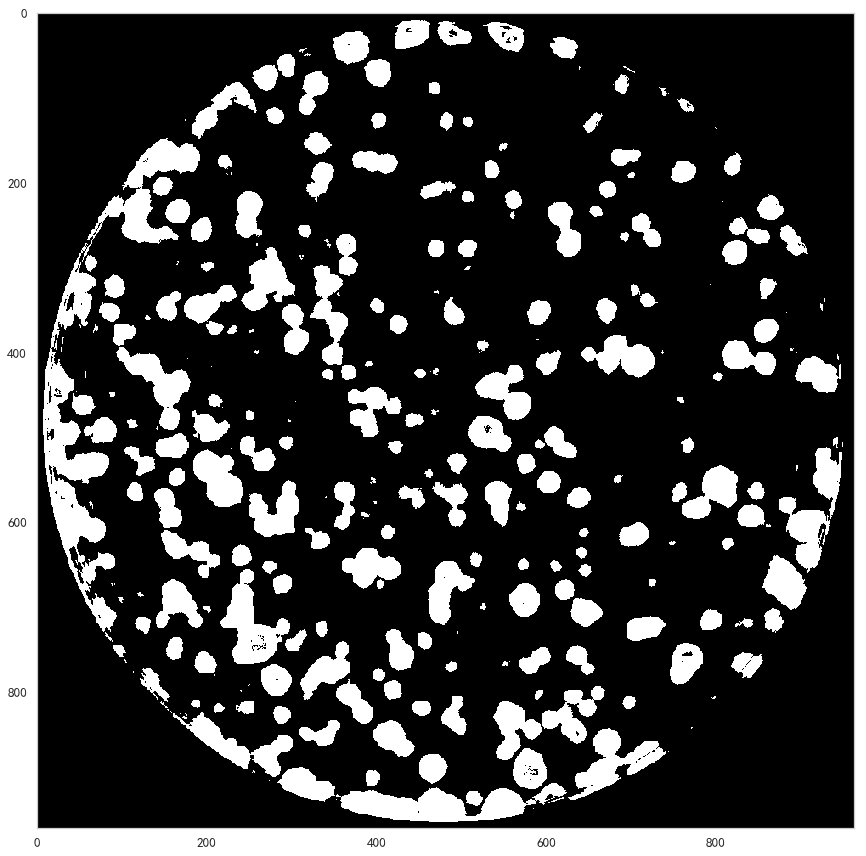

In [33]:
# 在SHV空间上过滤出和紫色相近的颜色
low_purple = np.array([130, 50, 50])  # [h, s, v]
high_purple = np.array([200, 250, 250])
mask1 = cv2.inRange(hsv, low_purple, high_purple)
plt_show(mask1, figsize=(20,15))

拿到mask相当于拿到辅助图, 下面找颜色阈值切割中影响比较显著的阈值和它合适的范围。

In [ ]:
# H 通道的取值（130 -- 200）
# low_purple1 = np.array([100, 0, 0])
# high_purple1 = np.array([150, 250, 200])
# mask1 = cv2.inRange(hsv, low_purple1, high_purple1)
# plt_show(mask1, figsize=(10,15))

# low_purple2 = np.array([100, 0, 0])
# high_purple2 = np.array([150, 250, 200])
# mask2 = cv2.inRange(hsv, low_purple2, high_purple2)
# plt_show(mask2, figsize=(10,15))

# low_purple3 = np.array([130, 0, 0])
# high_purple3 = np.array([210, 250, 200])
# mask3 = cv2.inRange(hsv, low_purple3, high_purple3)
# plt_show(mask3, figsize=(10,15))

# low_purple4 = np.array([200, 0, 0])  # 基本没有输出 所以这里H高于200 就没有意义了
# high_purple4 = np.array([250, 250, 200])
# mask4 = cv2.inRange(hsv, low_purple4, high_purple4)
# plt_show(mask4, figsize=(10,15))

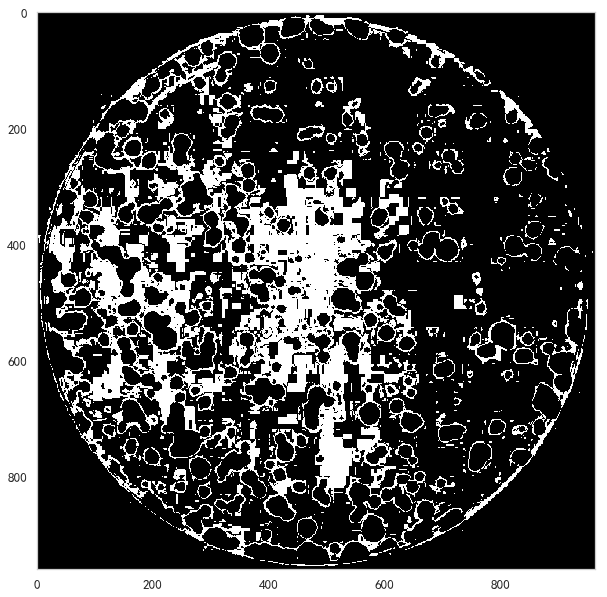

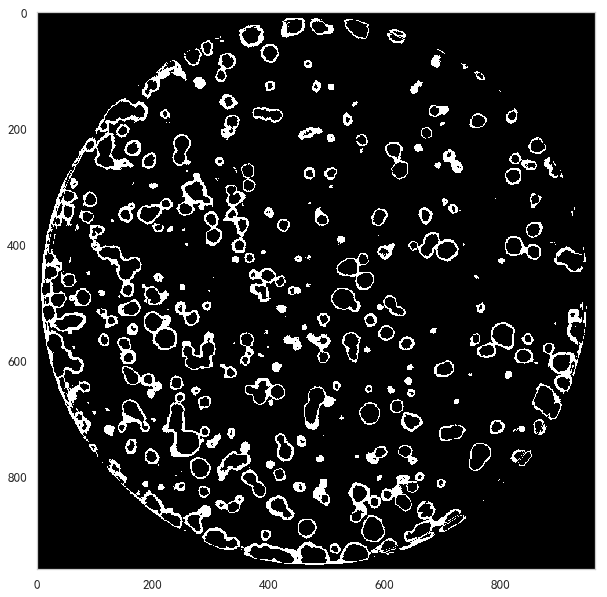

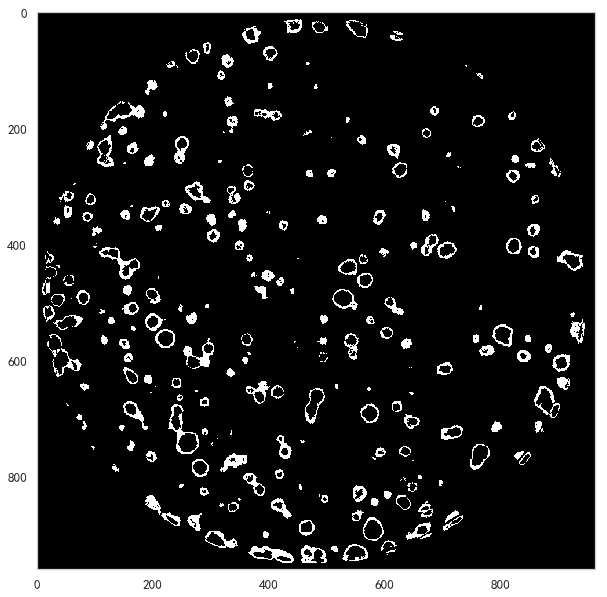

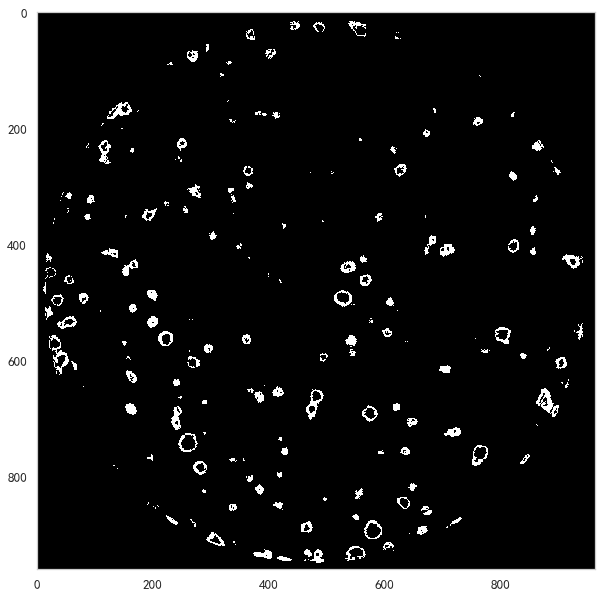

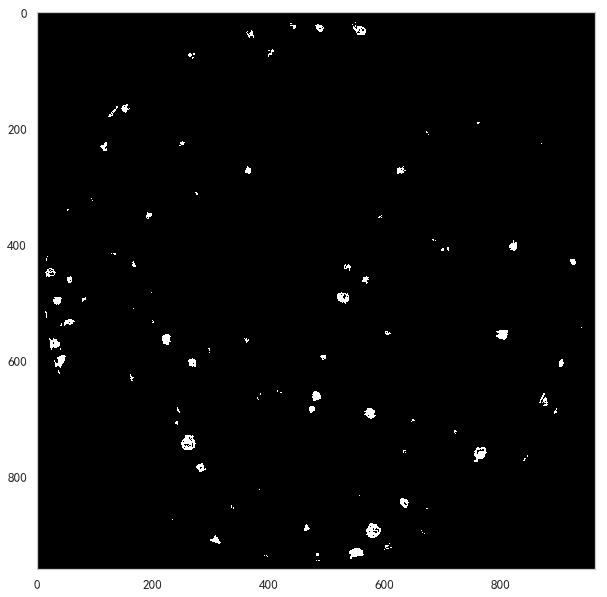

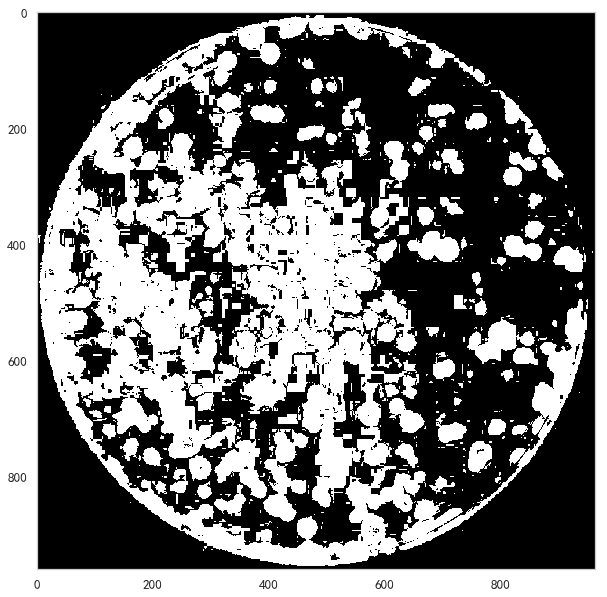

In [34]:
for i in range(5):
    low_purple = np.array([130, 50*i, 0])
    high_purple = np.array([200,50*(i+1), 200])
    mask = cv2.inRange(hsv, low_purple, high_purple)
    plt_show(mask, figsize=(10,15))
    
low_purple6 = np.array([130, 0, 0])   
high_purple6 = np.array([200, 250, 200])
mask6 = cv2.inRange(hsv, low_purple6, high_purple6)
plt_show(mask6, figsize=(10,15))

可以看到S值在50以下会引入较多的噪声，但是0-50部分保留了浅淡颜色的群落（灰色的群落），所以可以考虑0-250范围，并综合查全率因素和噪音因素可以考虑（50，200）

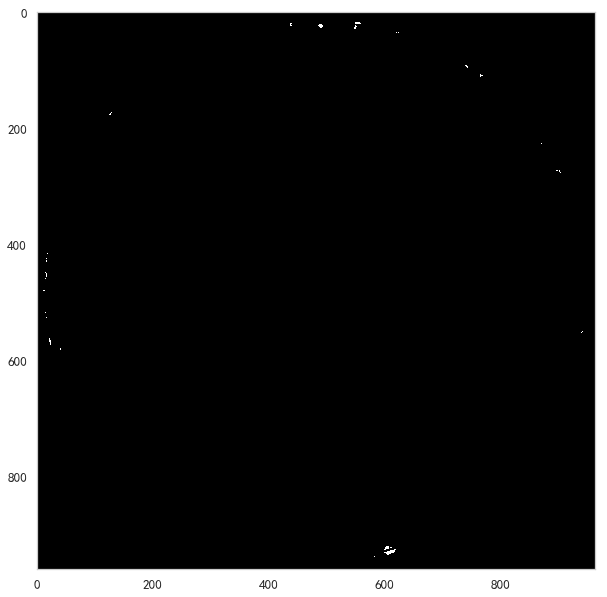

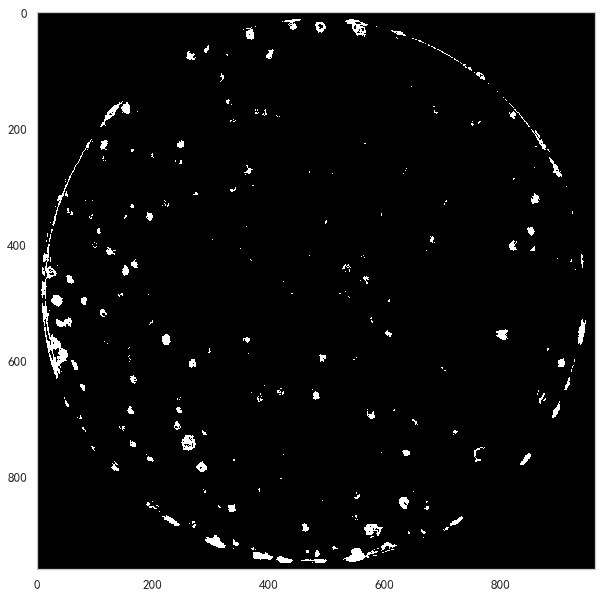

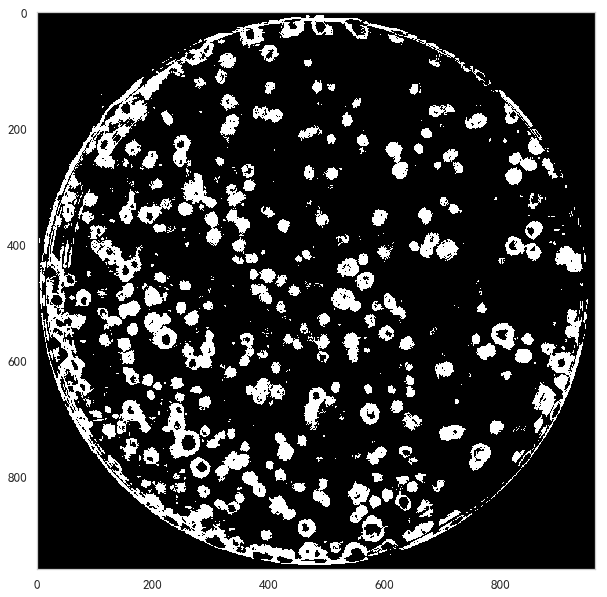

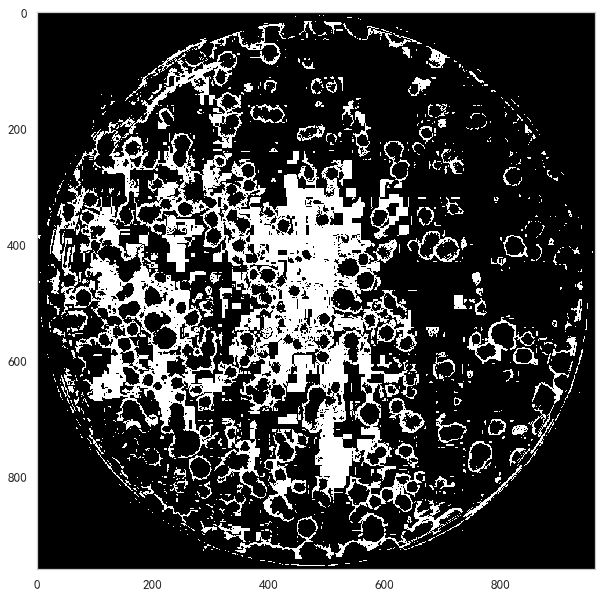

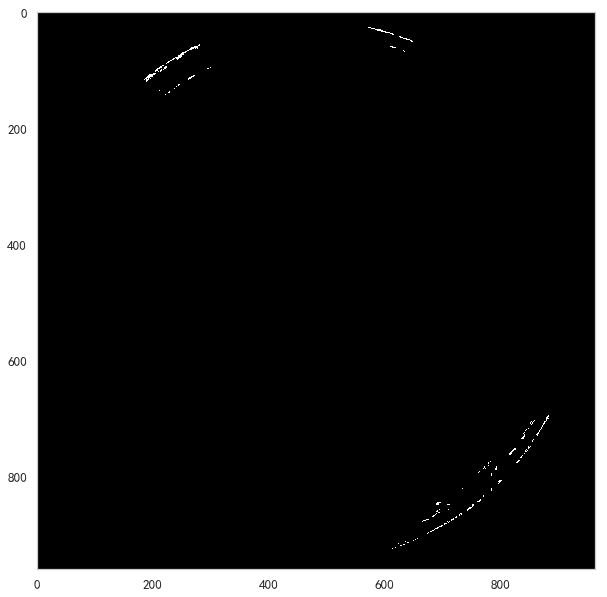

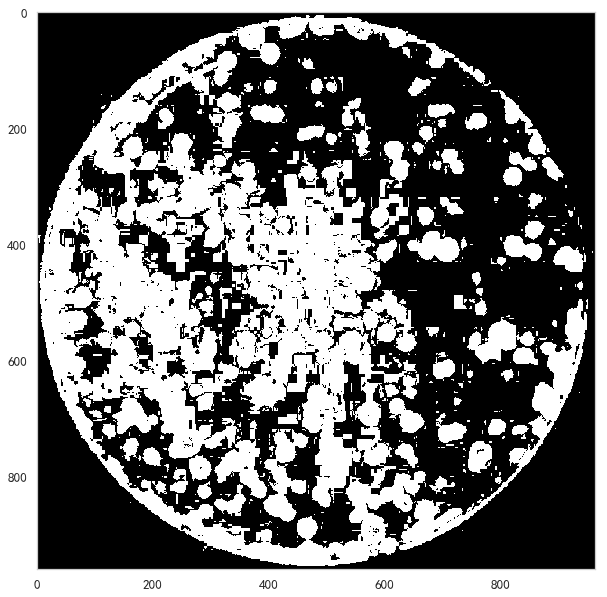

In [35]:
for i in range(5):
    low_purple = np.array([130, 0, 50*i])
    high_purple = np.array([200, 250, 50*(i+1)])
    mask = cv2.inRange(hsv, low_purple, high_purple)
    plt_show(mask, figsize=(10,15))
    
low_purple6 = np.array([130, 0, 0])   
high_purple6 = np.array([200, 250, 250])
mask6 = cv2.inRange(hsv, low_purple6, high_purple6)
plt_show(mask6, figsize=(10,15))

在V通道上低于50，高于200，得到的就都是噪声了，所以可以考虑设置V通到取值（50，200）
>综合分析后获得相对合理的阈值范围 low_purple = (130, 50, 50) ; high_purple = (200, 250, 200)

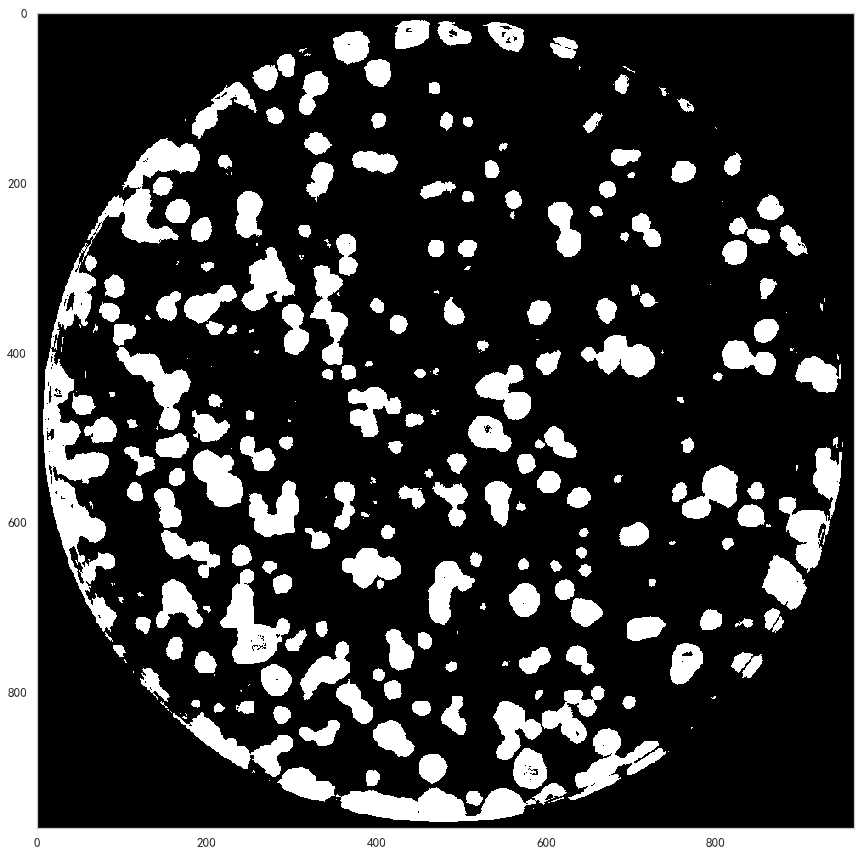

In [36]:
# 综合分析后获得相对合理的阈值范围
low_purple = np.array([130, 50, 50])   
high_purple = np.array([200, 250, 200])
mask = cv2.inRange(hsv, low_purple, high_purple)
plt_show(mask, figsize=(15,15))

**下面对辅助图做一些形态操作**

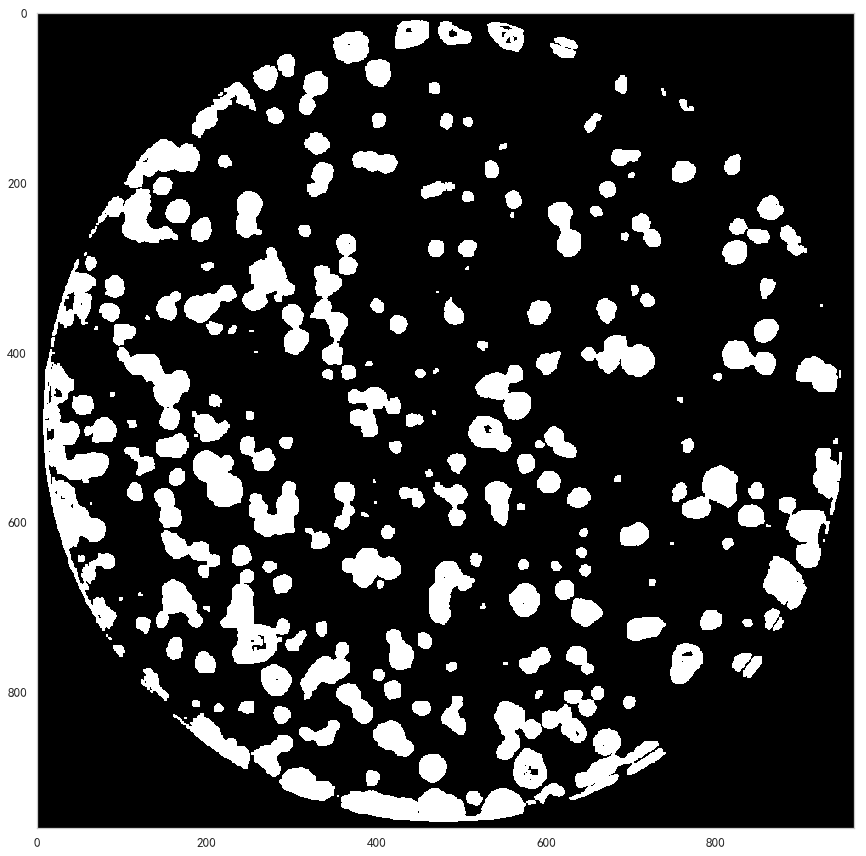

In [37]:
# 开运算 先腐蚀，再膨胀
kernel = np.ones((3,3),np.uint8) 
mask_opening = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
plt_show(mask_opening, figsize=(15,15))

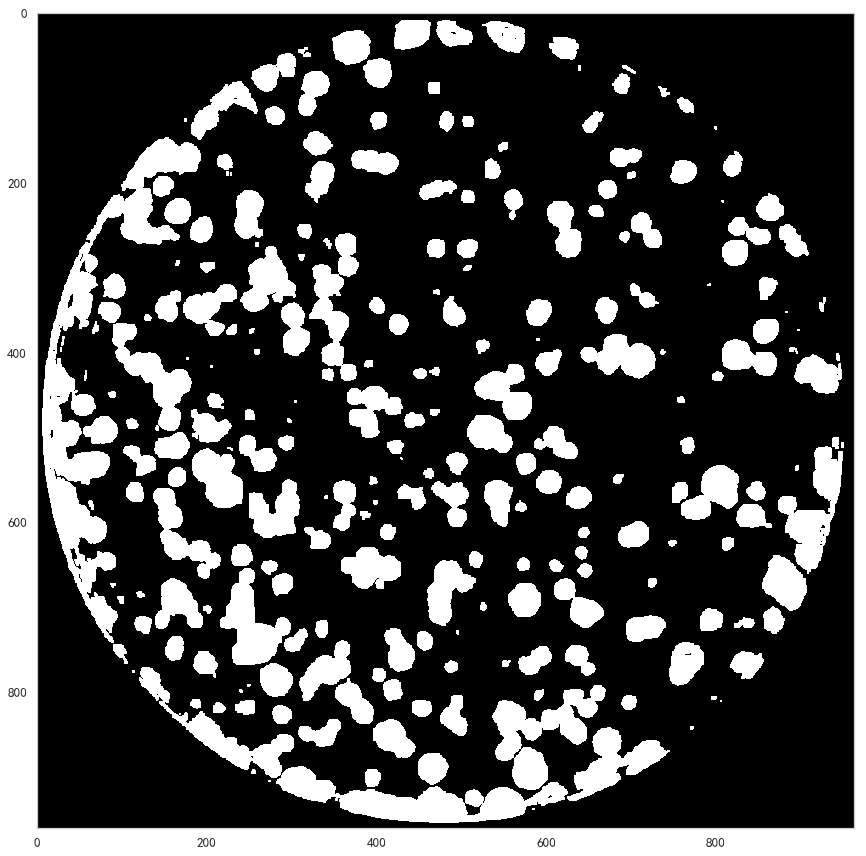

In [38]:
# 腐蚀操作
kernel = np.ones((3, 3), np.uint8)
mask_dilate = cv2.dilate(mask, kernel, iterations=1)  
plt_show(mask_dilate,figsize=(15,15))

开运算效果不好，直接使用膨胀操作

In [ ]:
# res = cv2.bitwise_and(img_origin, img_origin, mask=mask )
# plt_show(res, figsize=(10,10), gray=False)

In [39]:
def affirm_population_s(img_origin, contours, mim_area=10, max_area=20000):
    # 1 img_mask_bin 画板
    h, w, _ = img_origin.shape
    img_mask_bin = np.zeros((h, w))
    img_draw = img_origin.copy()
    population_cnts = []
    for i in range(len(contours)):
        cnt = contours[i]
        if  mim_area < cv2.contourArea(cnt) < max_area:  # 这里只通过面积来控制一下轮廓的选择
            cv2.drawContours(img_draw, cnt, -1, (255, 255, 0), 1)
            
            population_cnts.append(cnt)
            cv2.drawContours(img_mask_bin, cnt, -1, (255, 255, 255), cv2.FILLED)
            
    return population_cnts, img_mask_bin, img_draw

In [ ]:
contours_origin, hierarchy = cv2.findContours(mask_dilate, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)

img_origin = cv2.imread('data/Cell_population/187-1.jpg')
population_cnts, img_mask_bin, img_draw = affirm_population_s(img_origin, contours_origin)
plt_show(img_draw, figsize=(20,15), gray=False)
# plt_show(mask, figsize=(20,15))

In [ ]:
# 输出来看一下
# def cell_count(img_source, contours):
#     # affirm_population_p() 是计数标准
#     # popu_contours, erosion = affirm_population_p(img_source, contours)

#     for i, cnt in enumerate(contours):
#         try:
#             M = cv2.moments(cnt)
#             cx = int(M['m10'] / M['m00'])
#             cy = int(M['m01'] / M['m00'])
#             cv2.circle(img_source, (cx, cy), 2, (0, 255, 0), 1)
#             cv2.putText(img_source, str(i + 1), (cx + 5, cy + 5),
#                         cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (255, 255, 0), 1)
            
#         except:
#             print('missing %d' %i)
#             continue

#     plt_show(img_source, figsize=(20, 15))
#     #plt_show(erosion,  figsize=(20, 15), gray=True)
    
#     print('细胞个数为%d' % len(contours))
    
# # img_origin = cv2.imread('data/Cell_population/187-1.jpg')
# cell_count(img_origin, population_cnts)

**制定基于色彩空间的分割标准**

In [40]:
class CellPopulationMask:
    """在HSV空间上进行群落计数
    1）RGB原图转换到HSV空间
    2）在HSV空间上进行阈值切割得到mask 作为辅助图
    3）处理mask 用于后续轮廓查找
    4）画出轮廓并计数
    
    """
    def find_population(self, img_path, draw_cnts=True):
        """
        1) 读入图片
        2）找到轮廓
        3）画出轮廓
        4）输出个数
        """
        img_origin = cv2.imread(img_path)
        img_source = img_origin.copy()
        popu_contours = self.affirm_contours(img_origin)
        if draw_cnts:
            img_source = cv2.drawContours(img_source, popu_contours, -1, (0, 255, 155), 1)
            plt_show(img_source, figsize=(20, 15))
        return popu_contours, img_source
    
    def count(self, img_path, draw=True):
        popu_contours ,img_ = self.find_population(img_path)
        print('细胞个数为:%d' % len(popu_contours))

        for i, cnt in enumerate(popu_contours):
            try:
                M = cv2.moments(cnt)
                cx = int(M['m10'] / M['m00'])
                cy = int(M['m01'] / M['m00'])
                cv2.circle(img_, (cx, cy), 2, (0, 255, 0), 1)
                cv2.putText(img_, str(i + 1), (cx + 5, cy + 5),
                            cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)

            except:
                print('missing %d' %i)
                continue

        plt_show(img_, figsize=(20, 15))
 
    def affirm_contours(self, img_origin, min_area=20, max_area=20000):
        mask = self._creterions(img_origin)
        mask_cnts, hierarchy = cv2.findContours(mask, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
        
        population_cnts = []
        for i in range(len(mask_cnts)):
            cnt = mask_cnts[i]
            if  min_area < cv2.contourArea(cnt) < max_area:  # 这里只通过面积来控制一下轮廓的选择
                population_cnts.append(cnt)
        return population_cnts

    def _creterions(self, img_soruce, low=[130, 50, 50], up=[200, 250, 200]):
        # 1 颜色转换
        img_hsv = cv2.cvtColor(img_soruce, cv2.COLOR_RGB2HSV)
        # 2 阈值过滤
        low_purple = np.array(low)   
        high_purple = np.array(up)
        mask = cv2.inRange(img_hsv, low_purple, high_purple)
        # 3 膨胀处理二值轮廓掩膜
        kernel = np.ones((3, 3), np.uint8)
        mask_dilate = cv2.dilate(mask, kernel, iterations=1)  
        return mask_dilate
     

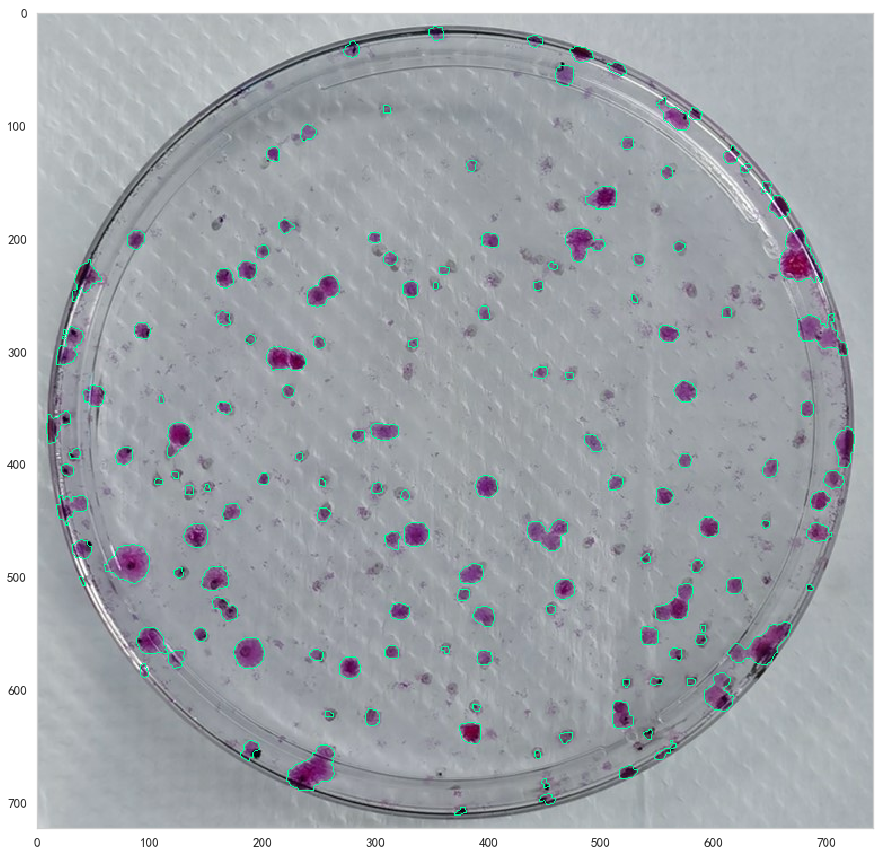

细胞个数为:143


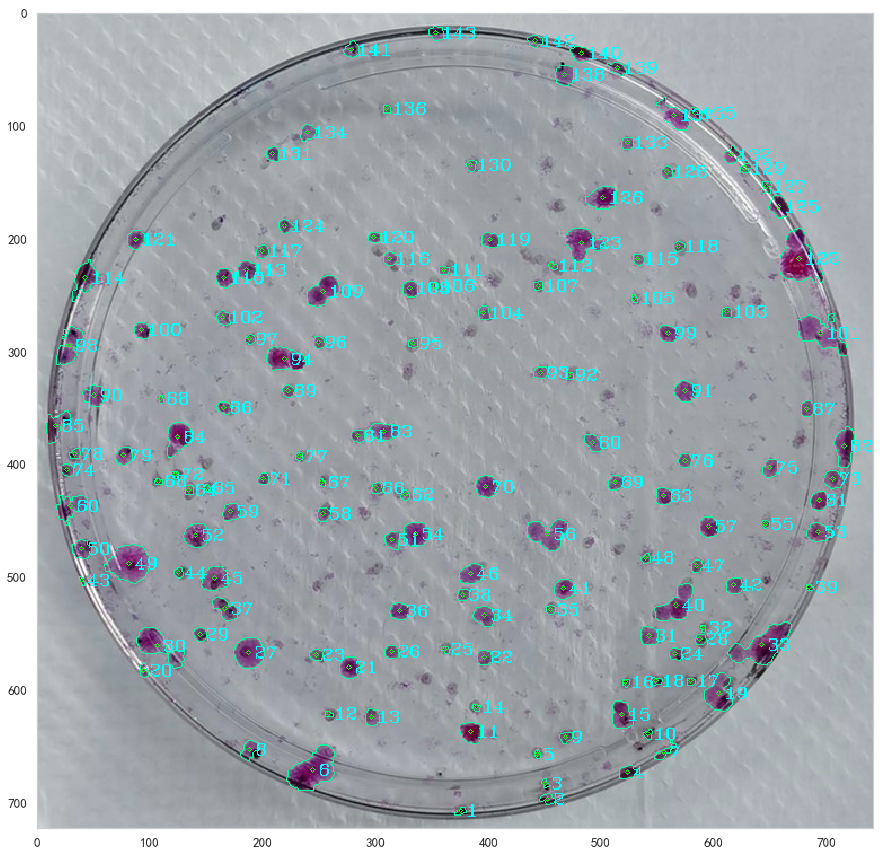

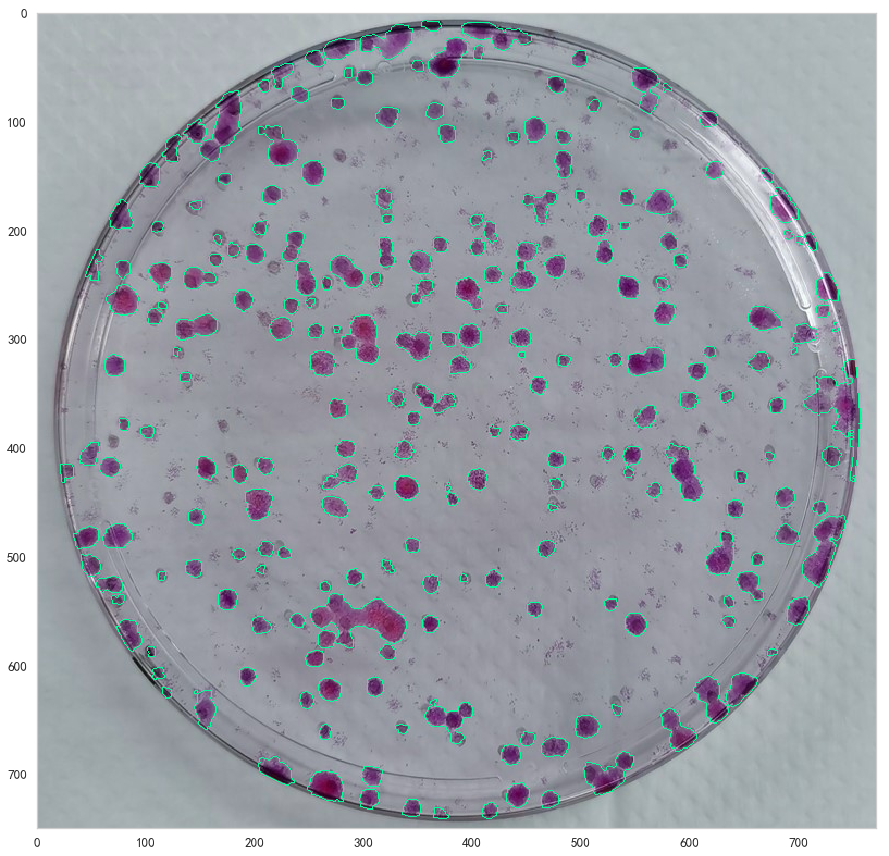

细胞个数为:227


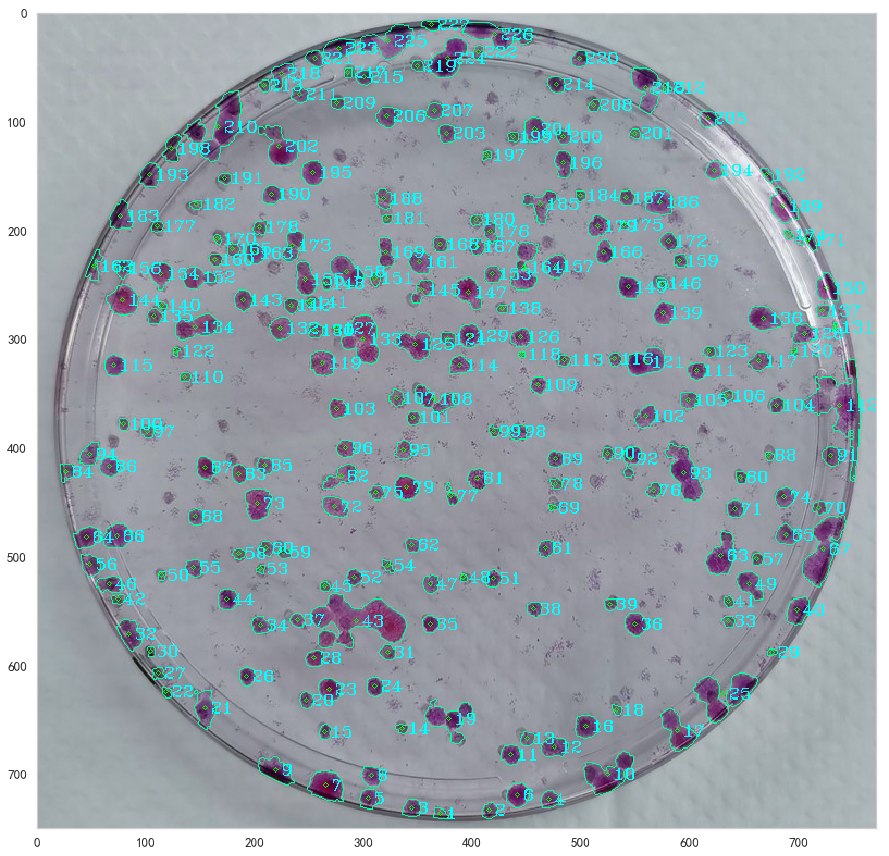

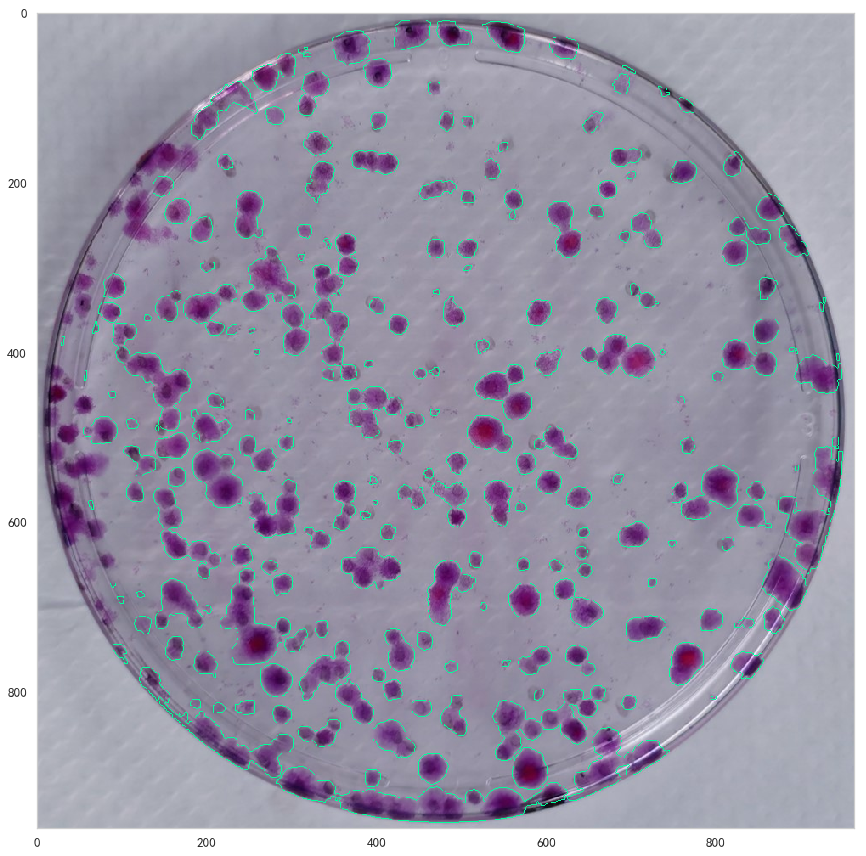

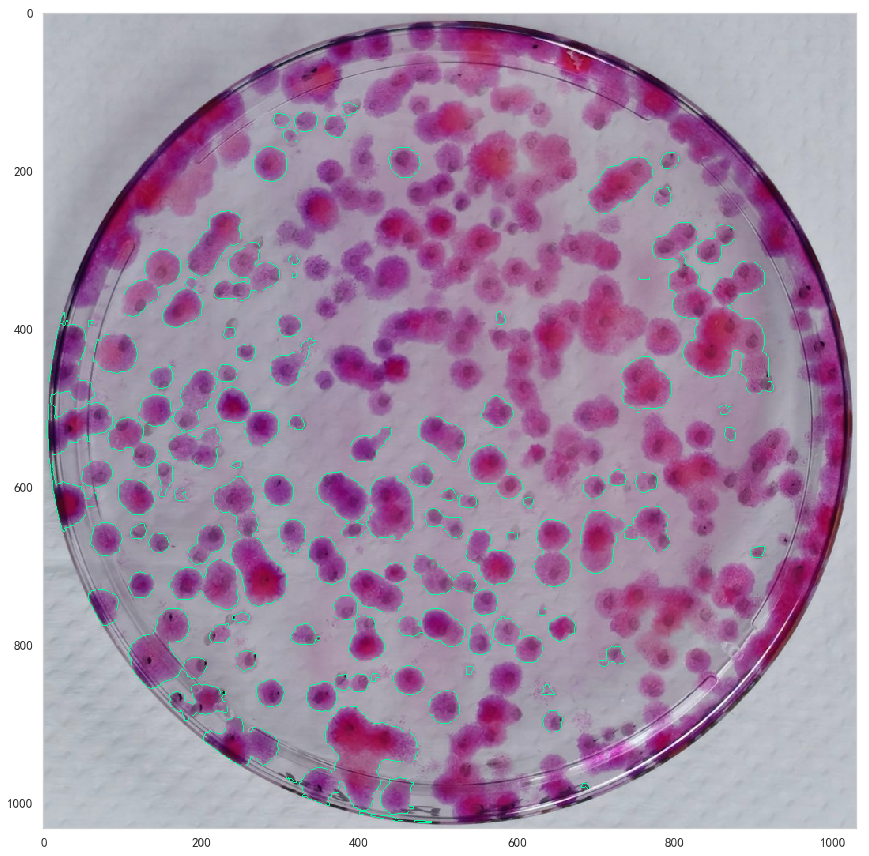

In [42]:
cell_mask = CellPopulationMask()
cell_mask.count('data/cells1/187-1.jpg')
cell_mask.count('data/cells1/296-1.jpg')
cnt_info = cell_mask.find_population('data/cells1/308-1.jpg')
cnt_info = cell_mask.find_population('data/cells1/313-1.jpg')

## 第一次算法优化

经过对比发现，在HSV空间上进行分割可以排除培养皿边缘的影响，得到较好的轮廓信息.同时出现的问题是：
>1) 第四天的群落轮廓提取不充分，应该单独分析处理，并制定兼容性规则。

>2) 分割连在一起的群落轮廓，提高计算精度

In [ ]:
HSV_filtered_cnts, hierarchy = cv2.findContours(mask_dilate, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)

In [49]:
class PopuContourAnalyser:
    def __init__(self, counters, img_src):
        self.cnts = counters
        self.img = img_src
        self.total_popu = 0
    def __getitem__(self, index):
        count = 0
        img_draw = self.img.copy()
        cnt = self.cnts[index]
        
        single_popu = cv2.drawContours(img_draw, cnt, -1, (255,255,0), 1)  # 实行了一个操作
        plt_show(img_draw, figsize=(20,15))
        #self.draw_index(cnt, index)
        
    def show_cnts(self):
        plt_show(self.img, figsize=(20, 15))
        
    def draw_index(self, cnt, index):
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(self.img, (cx, cy), 2, (0, 255, 0), 1)
        cv2.putText(self.img, str(index), (cx + 5, cy + 5),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)
        # plt_show(self.img, figsize=(20, 15))

In [ ]:
for i in range(len(HSV_filtered_cnts)):
    popu_analyser[i]

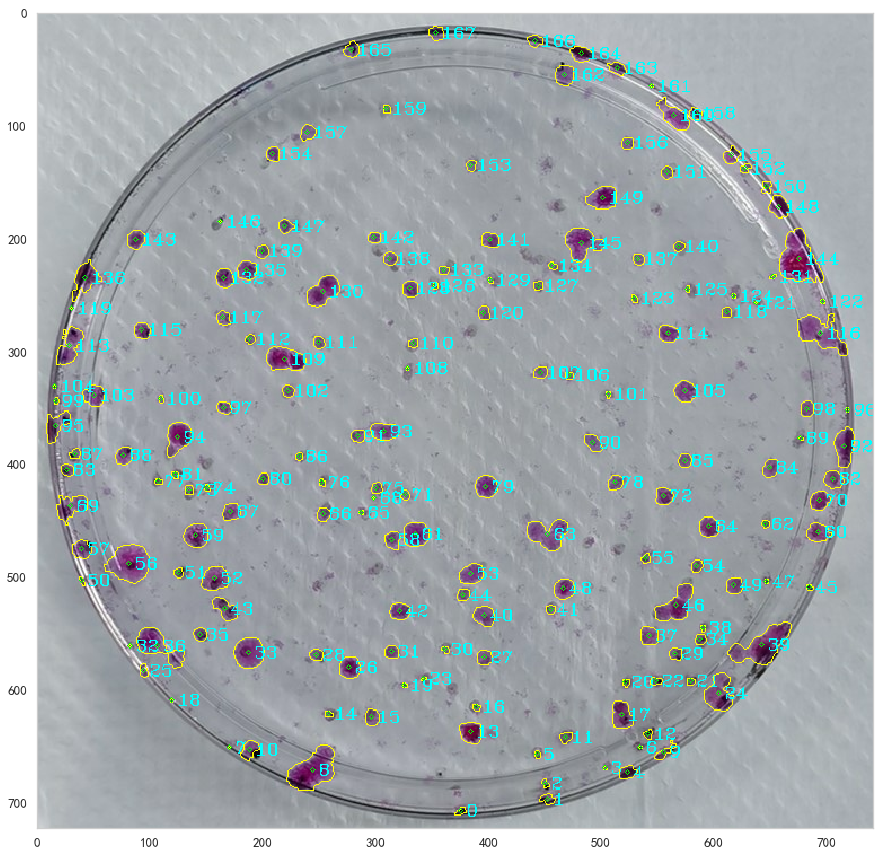

In [152]:
popu_analyser.show_cnts()

当前整体的逻辑是，1）先在颜色的维度上，找到，想要的轮廓，2）然后一个一个分析每一个轮廓有包含多少个群落
>TODO:每个轮廓都这么处理 浪费了很多计算量， 下一步考虑分流计算。

In [50]:
img = cv2.imread('data/Cell_population/187-1.jpg')
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img)

In [ ]:
for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]

In [ ]:
popu_analyser.show_cnts()
popu_analyser.total_popu

In [ ]:
# 计数测试
popu_analyser[145]

popu_analyser[144]

popu_analyser[63]

popu_analyser[39]

popu_analyser[24]

popu_analyser[46]

popu_analyser[8]

popu_analyser.total_popu

In [ ]:
# 计数测试
popu_analyser[153]

popu_analyser[141]

popu_analyser[90]

popu_analyser.total_popu

### 代码重构
**TODO 思考这么写背后的目的是什么？**

In [43]:
class HsvFilteredCnts:
    """从原始图片经过HSV颜色分割拿到合适的轮廓
    inp: img path
    out: filtered contours of cell populations
    """
    def affirm_contours(self, img_path, min_area=9, max_area=10000000):
        # 1 读入图片
        img_origin = cv2.imread(img_path)
        # 2 颜色分割
        mask_dilate = self._hsv_creterions(img_origin)
        # 3 拿到轮廓
        mask_cnts, hierarchy = cv2.findContours(mask_dilate, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
        # 4 轮廓过滤
        population_cnts = []
        for i in range(len(mask_cnts)):
            cnt = mask_cnts[i]
            if  min_area < cv2.contourArea(cnt) < max_area:  # 这里只通过面积来控制一下轮廓的选择
                population_cnts.append(cnt)
        # 5 返回处理后的轮廓
        return population_cnts, img_origin
    
    def _hsv_creterions(self, img, low=[130, 50, 50], up=[200, 250, 200]):
        # 1 颜色转换
        img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        # 2 阈值过滤
        low_purple = np.array(low)   
        high_purple = np.array(up)
        mask = cv2.inRange(img_hsv, low_purple, high_purple)
        # 3 膨胀处理二值轮廓掩膜  这一步的处理也相对关键 优化了返回的轮廓结果
        kernel = np.ones((3, 3), np.uint8)
        mask_dilate = cv2.dilate(mask, kernel, iterations=1)  
        return mask_dilate

In [44]:
class PopuContourAnalyser:
    """分析每个轮廓中一共有几个群落
    
    先画一些辅助图以bin_开头
    没有连接在一起的群落可以不用这个函数分析
    """
    def __init__(self, counters, img_src):
        self.cnts = counters  # 传进来所有的轮廓
        self.img = img_src
        self.total_popu = 0
        self.h, self.w, _ = img_src.shape

    def __getitem__(self, index):
        count = 0
        # img_draw = self.img.copy()  # 每次把轮廓画到不同的图上
        img_draw = self.img  # 每次都把轮廓画到同一张图上
        # 1 首先直接画出 这个 轮廓
        cnt = self.cnts[index]  # 轮廓
        cv2.drawContours(img_draw, cnt, -1, (255, 255, 0), 1)  # 将轮廓cnt画到图img_draw上
        
        # 2 分析连接在一起的轮廓cnt中有几个群落  大轮廓 - 小轮廓 的图
        img_bin = self._bin_count_with_hull(cnt)  
        # ---------------------- 算法核心 --------------------------
        
        # 3 找到计数轮廓
        popu_acount_cnts = self.find_popu_cnts(img_bin)
        popu_num = len(popu_acount_cnts)
        if popu_num == 0:
            popu_num += 1
        # 4 把群落的个数写在轮廓旁边
        self.draw_number(img_draw, cnt, popu_num)
        # 5 累计所有的群落数
        self.total_popu += popu_num
        #single_popu_conts = cv2.drawContours(img_draw, popu_acount, -1, (255, 0, 0), 1)
        #self._draw_index(cnt, index)
        #plt_show(img_draw, figsize=(20, 15))
        
    def find_popu_cnts(self, img_gray, min_area=4):
        """在生成轮廓的同时，过滤一些面积很小的轮廓
        args:
            img_gray:处理过的二值图像，包含用于计数的轮廓
        ret:
            good_cnts: 计数轮廓
        """
        good_cnts = []
        cnts, _ = cv2.findContours(img_gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        for cnt in cnts:
            area = cv2.contourArea(cnt)
            # print(area)
            if area > min_area:
                good_cnts.append(cnt)
        return good_cnts
    
    def draw_count_cnts(self, img, cnts):
        """辅助函数：画出计数轮廓 用红色线"""
        cv2.drawContours(img, cnts, -1, (255, 0, 0), 1)
        
    def draw_number(self, img, cnt, string):
        """将轮廓中群落的个数 写在轮廓旁边"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(img, (cx, cy), 2, (0, 255, 0), cv2.FILLED)
        cv2.putText(img, str(string), (cx + 5, cy - 10),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0, 255, 255), 1)
        
    def draw_index(self, cnt, index):
        """辅助函数：画出轮廓的索引用于后续分析"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(self.img, (cx, cy), 2, (0, 255, 0), 1)
        cv2.putText(self.img, str(index), (cx + 5, cy + 5),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)
    
    def show_cnts(self):
        plt_show(self.img, figsize=(20, 15))

    def bin_contours(self, cnt):
        """在二值图上画出轮廓的填充图"""
        img_bin = np.zeros((self.h, self.w))
        draw_bin = cv2.drawContours(img_bin, [cnt], -1, [255, 255, 255], cv2.FILLED)
        return draw_bin
        
    def bin_enclose_circle(self, cnt):
        """在二值图上画出轮廓内接圆的填充图"""
        img_bin = np.zeros((self.h, self.w))
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        center = (int(x), int(y))
        radius = int(radius)
        draw_bin = cv2.circle(img_bin, center, radius, (255, 255, 255), cv2.FILLED)
        return draw_bin
    
    def bin_hull(self, cnt):
        """在二值图上画出轮廓凸包的填充图"""
        img_bin = np.zeros((self.h, self.w))
        hull = cv2.convexHull(cnt, False)
        res = cv2.drawContours(img_bin, [hull], -1, (255, 255, 255), cv2.FILLED)
        return res
    
    def _bin_count_with_circle(self, cnt):
        """使用轮廓外接圆减去轮廓后剩下的图形作为计数轮廓"""
        bin_circle = self.bin_enclose_circle(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_circle, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
  
        #print(type(bin_sub), bin_sub.shape, bin_sub)
        #plt_show(bin_circle, figsize=(20,15))
        #plt_show(bin_cnt, figsize=(20,15))
        #plt_show(bin_sub_thresh, figsize=(20,15))
        return bin_sub_thresh

    def _bin_count_with_hull(self, cnt):
        """使用轮廓外接凸包减去轮廓后剩下的图形作为计数轮廓"""
        bin_hull = self.bin_hull(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_hull, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)  # .astype(np.unit8) np数值类型转化
        
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
        
#         plt_show(bin_hull, figsize=(20,15))
#         plt_show(bin_cnt, figsize=(20,15))
#         plt_show(bin_sub_thresh, figsize=(20,15))

        return bin_sub_thresh  

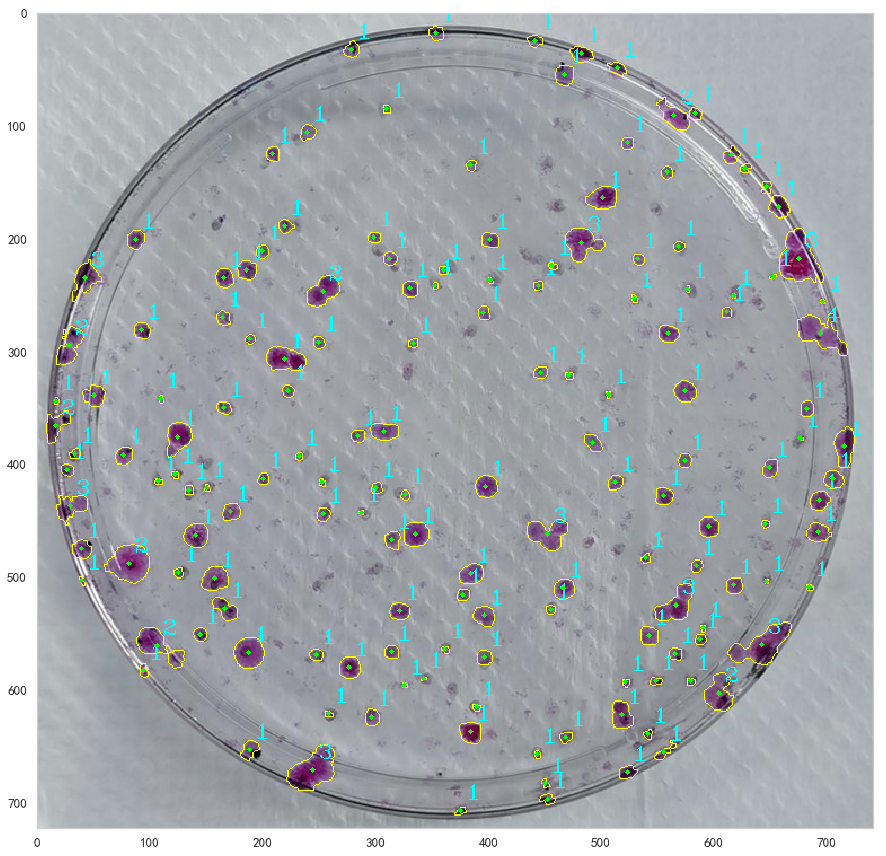

细胞群落检测个数：181;实际群落数：187


In [45]:
img_path = 'data/cells1/187-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]

popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：187'.format(popu_analyser.total_popu))

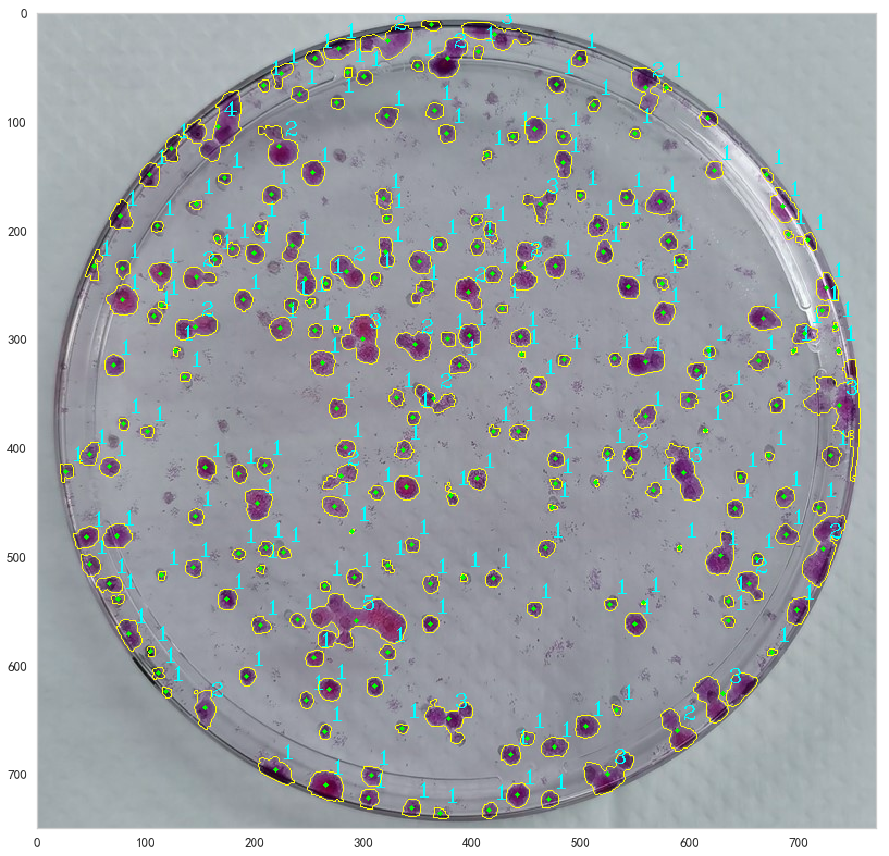

细胞群落检测个数：273;实际群落数：296


In [46]:
img_path = 'data/cells1/296-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]
    
popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：296'.format(popu_analyser.total_popu))

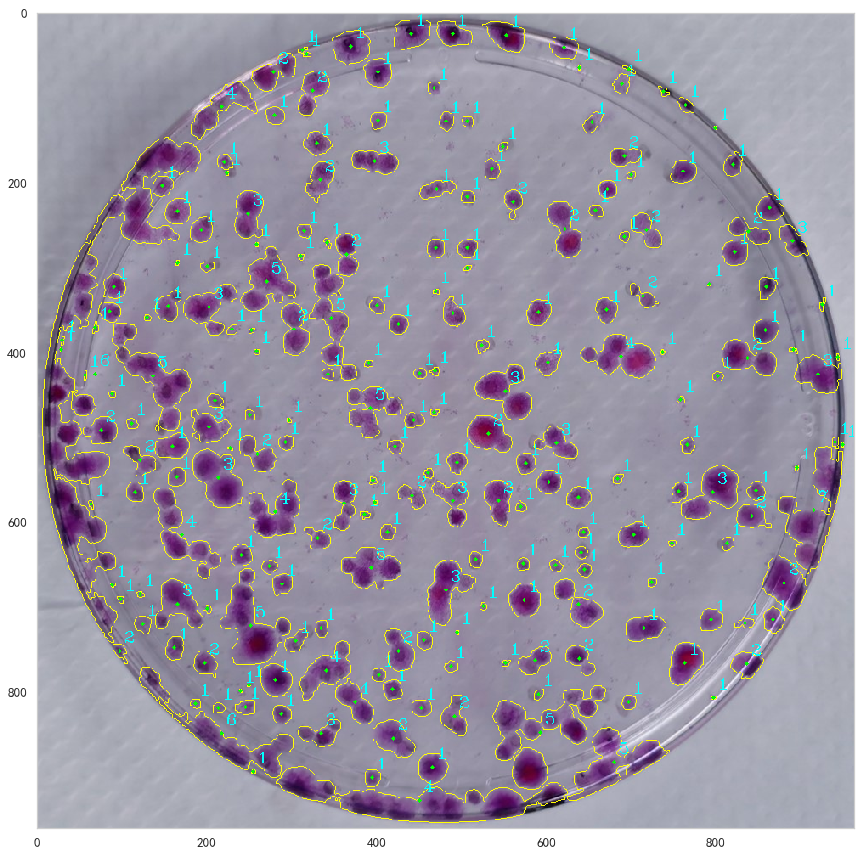

细胞群落检测个数：350;实际群落数：308


In [47]:
img_path = 'data/cells1/308-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]
    
popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：308'.format(popu_analyser.total_popu))

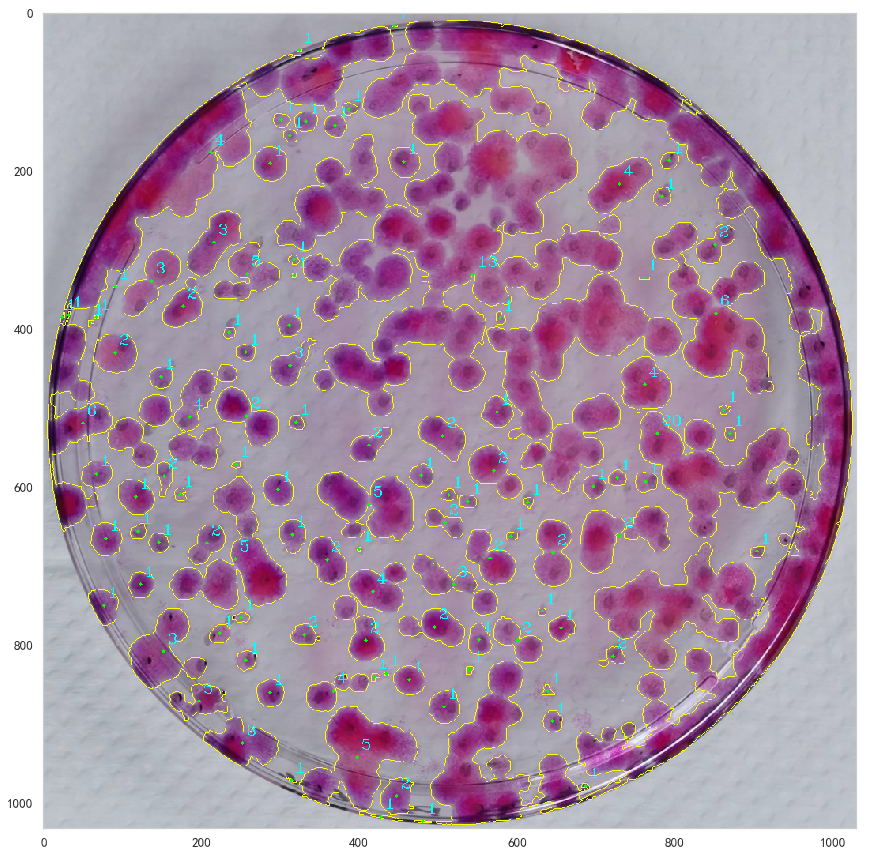

细胞群落检测个数：219;实际群落数：313


In [48]:
img_path = 'data/cells1/313-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]
    
popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：313'.format(popu_analyser.total_popu))

## 准确率和召回率分析

细胞群落计算标准：
    一般定义CFU，是说细胞在体外增殖6次形成的集落，也就是50个细胞以上。按照我之前对CFU定义条件的摸索实验得出的结论就是直径小于0.1cm的颜色较深群落，以及直径在0.1cm-0.2cm之间的群落，直径大于0.2cm的颜色较深的群落。
    
    颜色的深浅是由聚集的细胞数以及聚集程度决定的，一般克隆群的生长都是呈聚集生长，聚集程度较高，这样的克隆群染完后颜色就很深。
    
检测的标准:
    
>1)直径小于0.1cm的颜色较深群落，2)以及直径在0.1cm-0.2cm之间的群落，2)直径大于0.2cm的颜色较深的群落。

    这个定义的话应该只需要关注"直径小于0.1cm的颜色"和"直径大于0.2的颜色"就可以。一般大多数直径大于0.2cm的群落，它的颜色都很深了，只是有少部分细胞没有克隆能力但是在生长过程中逐渐靠近，这样染出的颜色肉眼也能看出，但颜色较浅。

<img src="./data/Cell_population/feedback1.png"  alt=""  width="800"  height="500"  align="botton"/>


| Pre\T | P:187 |N |
| :-----:| :----: | :----: |
| P:181 | TP:167 | FP:14 |
| N:20 | FN:20 | TN:0 |

$Acc = \frac{TP+TN}{Total}=\frac{167}{167+14+20}\simeq 0.83 $;$Pre = \frac{TP}{TP+FP}=\frac{167}{181}\simeq 0.92$;
$Rec = \frac{TP}{TP+FN}=\frac{167}{187}\simeq 0.89$

如何解释TN：首先，我们不想检测某一类物体，然后我们的检测器就没有检测它，我们就说检测器正确地处理了这一类物体

<img src="./data/Cell_population/feedback2.png"  alt=""  width="800"  height="500"  align="botton"/>


| Pre\T | P:296 |N |
| :-----:| :----: | :----: |
| P:273 | TP:268 | FP:5 |
| N: | FN:28 | TN:0 |

$Acc = \frac{TP+TN}{Total}=\frac{268}{268+28+5}\simeq 0.91 $;$Pre = \frac{TP}{TP+FP}=\frac{268}{273}\simeq 0.98$;
$Rec = \frac{TP}{TP+FN}=\frac{268}{296}\simeq 0.90$

<img src="./data/Cell_population/feedback3.png"  alt=""  width="800"  height="500"  align="botton"/>


| Pre\T | P:332 |N |
| :-----:| :----: | :----: |
| P:344 | TP:304 | FP:40 |
| N: | FN:28 | TN:0 |

$Acc = \frac{TP+TN}{Total}=\frac{304}{304+40+28}\simeq 0.82 $;$Pre = \frac{TP}{TP+FP}=\frac{304}{344}\simeq 0.88$;
$Rec = \frac{TP}{TP+FN}=\frac{268}{296}\simeq 0.92$

In [ ]:
(0.82+0.83+0.91)/3

以上三张图片的检测准确率的平均值为：0.853

## 第二次算法优化

 分析第四天的图片的HSV滤波轮廓
>1）针对第四天的细胞群落做检出优化

>2）注意输入图片大小的不同将，将图片缩放到统一大小后处理，增加算法处理的稳定性


In [53]:
img1 = cv2.imread('data/cells1/187-1.jpg')
h,w,c = img1.shape  # （h, w, c) 
print(h,w,c)

723 742 3


In [54]:
img2 = cv2.imread('data/cells1/296-1.jpg')
img2.shape

(750, 772, 3)

In [55]:
img3 = cv2.imread('data/cells1/308-1.jpg')
img3.shape

(961, 963, 3)

In [56]:
img4 = cv2.imread('data/cells1/313-1.jpg')
img4.shape

(1033, 1030, 3)

In [57]:
nw = 900
nh = int(900*(h / w))
print(nw,nh)
img = cv2.resize(img1, (nw, nh), interpolation=cv2.INTER_CUBIC)  # 使用cv2.resize时，参数输入是 宽×高×通道
img.shape

900 876


(876, 900, 3)

In [58]:
class HsvFilteredCnts:
    """从原始图片经过HSV颜色分割拿到合适的轮廓
    inp: img path
    out: filtered contours of cell populations
    """
    def affirm_contours(self, img_path, min_area=10, max_area=150000):  # 810,000
        # 1 读入图片
        img_origin = cv2.imread(img_path)
        # 2 将图片大小等比缩放到h=900, w=900*scale
        h, w, _ = img_origin.shape
        nh, nw = 900, int(900 * (w / h))  
        
        img_resize = cv2.resize(img_origin, (nw, nh), interpolation=cv2.INTER_CUBIC)
        # 3 颜色分割
        mask_dilate = self._hsv_creterions(img_resize)
        # 4 拿到轮廓
        mask_cnts, hierarchy = cv2.findContours(mask_dilate, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
        # 5 轮廓过滤
        population_cnts = []
        for i in range(len(mask_cnts)):
            cnt = mask_cnts[i]
            if  min_area < cv2.contourArea(cnt) < max_area:  # 这里只通过面积来控制一下轮廓的选择
                population_cnts.append(cnt)
        # 6 返回处理后的轮廓
        return population_cnts, img_resize
    
    def _hsv_creterions(self, img, low=[130, 50, 50], up=[200, 250, 200]):
        # 1 颜色转换
        img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        # 2 阈值过滤
        low_purple = np.array(low)   
        high_purple = np.array(up)
        mask = cv2.inRange(img_hsv, low_purple, high_purple)
        # 3 膨胀处理二值轮廓掩膜  这一步的处理也相对关键 优化了返回的轮廓结果
        kernel = np.ones((3, 3), np.uint8)
        
#         mask_opening = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)  # 
        mask_dilate = cv2.dilate(mask, kernel, iterations=1)
        return mask_dilate

In [59]:
class PopuContourAnalyser:
    """分析每个轮廓中一共有几个群落
    
    先画一些辅助图以bin_开头
    没有连接在一起的群落可以不用这个函数分析
    """
    def __init__(self, counters, img_src):
        self.cnts = counters  # 传进来所有的轮廓
        self.img = img_src
        self.total_popu = 0
        self.h, self.w, _ = img_src.shape

    def __getitem__(self, index):
        count = 0
        # img_draw = self.img.copy()  # 每次把轮廓画到不同的图上
        img_draw = self.img  # 每次都把轮廓画到同一张图上
        # 1 首先直接画出 这个 轮廓
        cnt = self.cnts[index]  # 轮廓
        cv2.drawContours(img_draw, cnt, -1, (255, 255, 0), 1)  # 将轮廓cnt画到图img_draw上
        
        # 2 分析连接在一起的轮廓cnt中有几个群落  大轮廓 - 小轮廓 的图
        img_bin = self._bin_count_with_hull(cnt)  
        # ---------------------- 算法核心 --------------------------
        
        # 3 找到计数轮廓
        popu_acount_cnts = self.find_popu_cnts(img_bin)
        popu_num = len(popu_acount_cnts)
        if popu_num == 0:
            popu_num += 1
        # 4 把群落的个数写在轮廓旁边
        self.draw_number(img_draw, cnt, popu_num)
        # 5 累计所有的群落数
        self.total_popu += popu_num
        #single_popu_conts = cv2.drawContours(img_draw, popu_acount, -1, (255, 0, 0), 1)
        #self._draw_index(cnt, index)
        #plt_show(img_draw, figsize=(20, 15))
        
    def find_popu_cnts(self, img_gray, min_area=8):
        """在生成轮廓的同时，过滤一些面积很小的轮廓
        args:
            img_gray:处理过的二值图像，包含用于计数的轮廓
        ret:
            good_cnts: 计数轮廓
        """
        good_cnts = []
        cnts, _ = cv2.findContours(img_gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        for cnt in cnts:
            area = cv2.contourArea(cnt)
            # print(area)
            if area > min_area:
                good_cnts.append(cnt)
        return good_cnts
    
    def draw_count_cnts(self, img, cnts):
        """辅助函数：画出计数轮廓 用红色线"""
        cv2.drawContours(img, cnts, -1, (255, 0, 0), 1)
        
    def draw_number(self, img, cnt, string):
        """将轮廓中群落的个数 写在轮廓旁边"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(img, (cx, cy), 2, (0, 255, 0), cv2.FILLED)
        cv2.putText(img, str(string), (cx + 5, cy - 10),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0, 255, 255), 1)
        
    def draw_index(self, cnt, index):
        """辅助函数：画出轮廓的索引用于后续分析"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(self.img, (cx, cy), 2, (0, 255, 0), 1)
        cv2.putText(self.img, str(index), (cx + 5, cy + 5),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)
    
    def show_cnts(self):
        plt_show(self.img, figsize=(20, 15))

    def bin_contours(self, cnt):
        """在二值图上画出轮廓的填充图"""
        img_bin = np.zeros((self.h, self.w))
        draw_bin = cv2.drawContours(img_bin, [cnt], -1, [255, 255, 255], cv2.FILLED)
        return draw_bin
        
    def bin_enclose_circle(self, cnt):
        """在二值图上画出轮廓内接圆的填充图"""
        img_bin = np.zeros((self.h, self.w))
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        center = (int(x), int(y))
        radius = int(radius)
        draw_bin = cv2.circle(img_bin, center, radius, (255, 255, 255), cv2.FILLED)
        return draw_bin
    
    def bin_hull(self, cnt):
        """在二值图上画出轮廓凸包的填充图"""
        img_bin = np.zeros((self.h, self.w))
        hull = cv2.convexHull(cnt, False)
        res = cv2.drawContours(img_bin, [hull], -1, (255, 255, 255), cv2.FILLED)
        return res
    
    def _bin_count_with_circle(self, cnt):
        """使用轮廓外接圆减去轮廓后剩下的图形作为计数轮廓"""
        bin_circle = self.bin_enclose_circle(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_circle, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
  
        #print(type(bin_sub), bin_sub.shape, bin_sub)
        #plt_show(bin_circle, figsize=(20,15))
        #plt_show(bin_cnt, figsize=(20,15))
        #plt_show(bin_sub_thresh, figsize=(20,15))
        return bin_sub_thresh

    def _bin_count_with_hull(self, cnt):
        """使用轮廓外接凸包减去轮廓后剩下的图形作为计数轮廓"""
        bin_hull = self.bin_hull(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_hull, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)  # .astype(np.unit8) np数值类型转化
        
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
        
#         plt_show(bin_hull, figsize=(20,15))
#         plt_show(bin_cnt, figsize=(20,15))
#         plt_show(bin_sub_thresh, figsize=(20,15))

        return bin_sub_thresh  

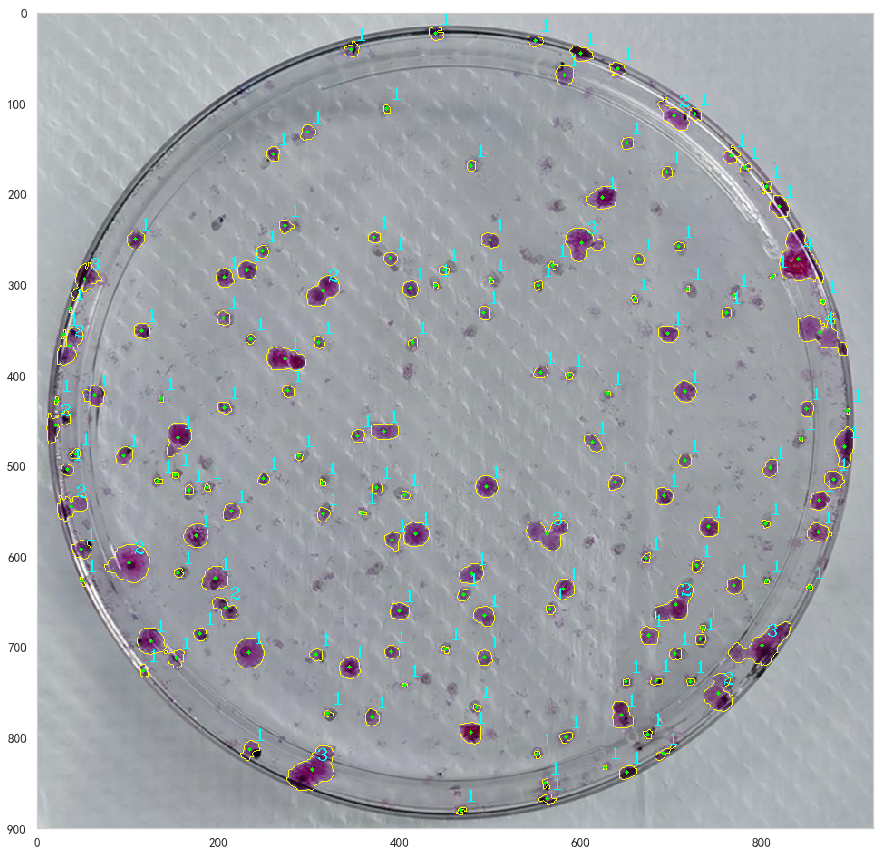

细胞群落检测个数：184;实际群落数：187


In [60]:
img_path = 'data/cells1/187-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]

popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：187'.format(popu_analyser.total_popu))

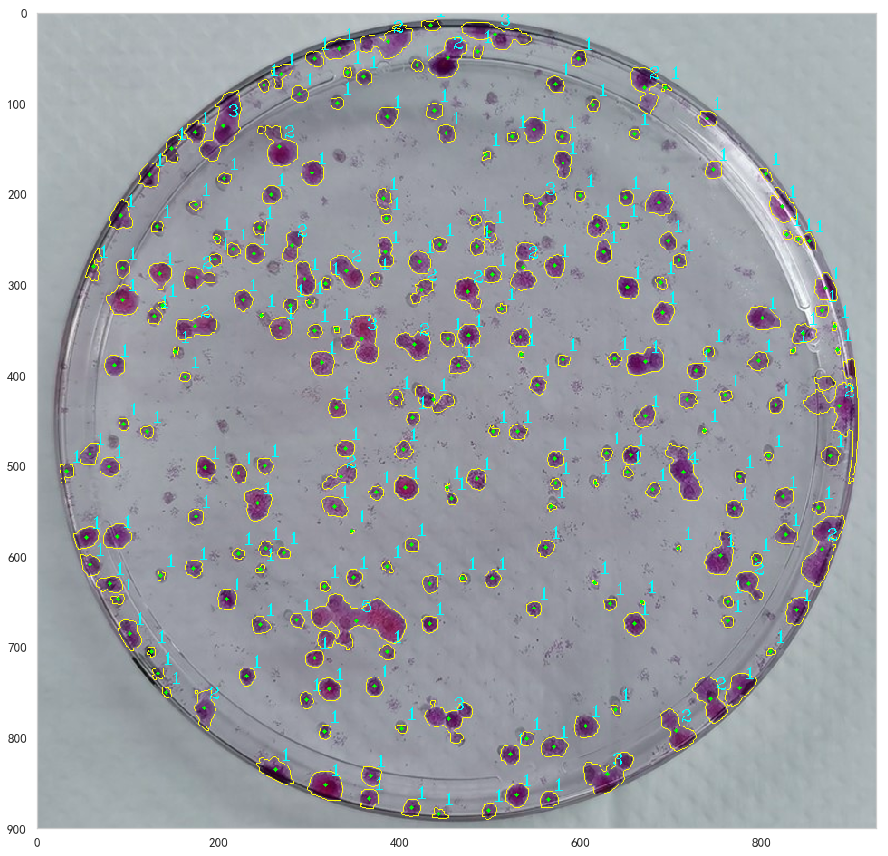

细胞群落检测个数：278;实际群落数：296


In [62]:
img_path = 'data/cells1/296-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]

popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：296'.format(popu_analyser.total_popu))

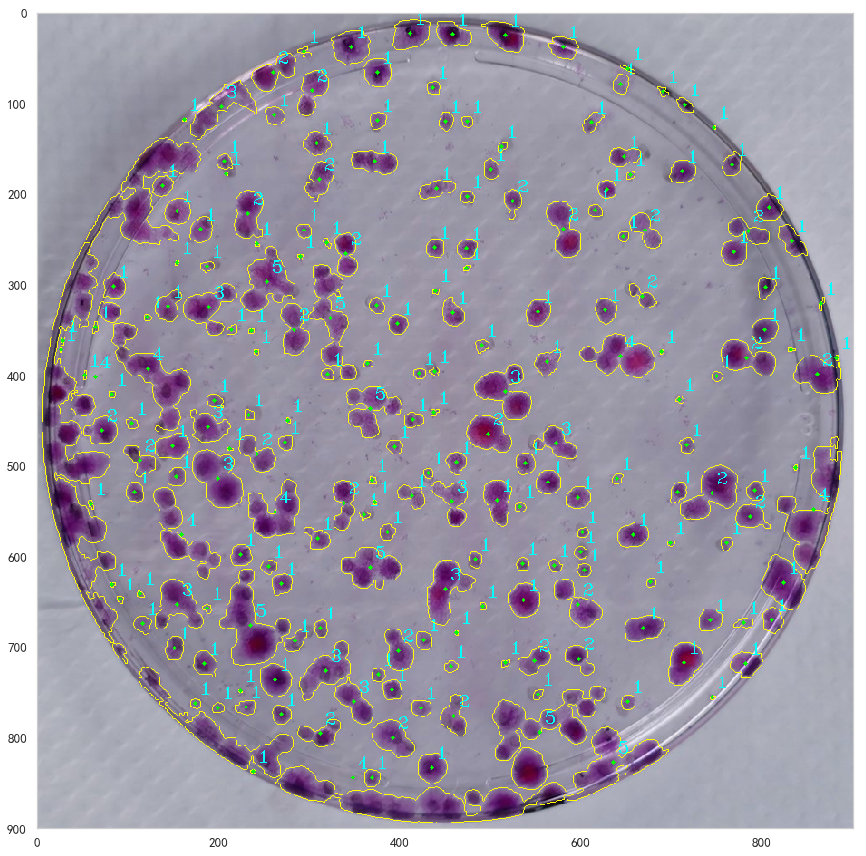

细胞群落检测个数：311;实际群落数：308


In [63]:
img_path = 'data/cells1/308-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]

popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：308'.format(popu_analyser.total_popu))

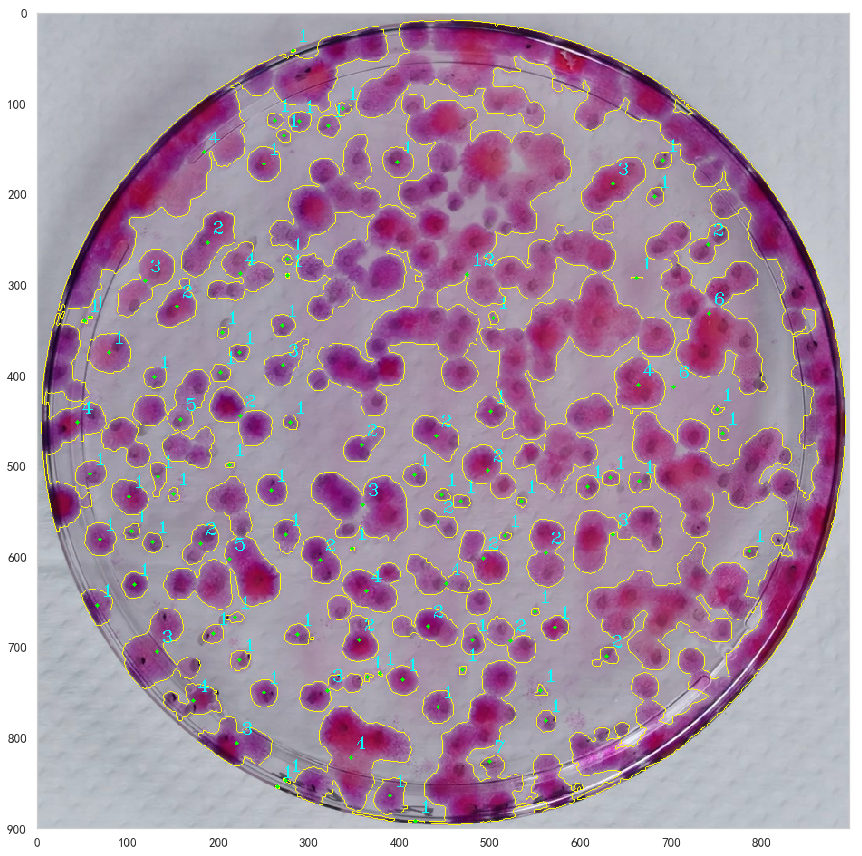

细胞群落检测个数：196;实际群落数：313


In [64]:
img_path = 'data/cells1/313-1.jpg'
HSV_filtered_cnts, img_origin = HsvFilteredCnts().affirm_contours(img_path)
popu_analyser = PopuContourAnalyser(HSV_filtered_cnts, img_origin)

for idx in range(len(HSV_filtered_cnts)):
    popu_analyser[idx]

popu_analyser.show_cnts()
print('细胞群落检测个数：{};实际群落数：313'.format(popu_analyser.total_popu))

分析发现，在经过HSV滤波后，集中进行形态学处理，不适用于大细胞群落，应后续单独分析处理每一个群落轮廓的形态。

### 定义类 负责拿到颜色轮廓 

In [66]:
class HsvFilter:
    """从原始图片经过HSV颜色分割拿到合适的轮廓
    inp: img path
    out: contours of cell populations and resized img
    1) 读入图片
    2）缩放
    3）hsv滤波
    4）初步筛选轮廓
    5）保存处理后的轮廓和图形
    """
    def __init__(self):
        self.img = None
        self.resized_img = None
        self.cnts = None
        
    def process(self, img_path):
        # 1 读入图片
        self.img = cv2.imread(img_path)
        # 2 将图片大小等比缩放到h=900, w=900*scale
        self.resized_img = self.resize(self.img)
        # 3 颜色分割
        mask = self._hsv_creterions(self.resized_img)
        #plt_show(mask, figsize=(20,15))  # test used
        # 4 拿到轮廓
        contours, hierarchy = cv2.findContours(mask, 
                                       cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_NONE)
        # 5 初步过滤掉一些轮廓
        self.cnts = self._fileter_cnts(contours)
        #cv2.drawContours(self.resized_img, self.cnts, -1, (255,255,0), 1)  # 可视化 cnts (optional)
        #plt_show(self.resized_img, figsize=(20,15))  # optional
        
    def _hsv_creterions(self, img, low=[130, 50, 50], up=[200, 250, 200]):
        """这里返回的轮廓是后续群落计数的基础
        直接返回过滤后的全图轮廓
        """
        # 1 颜色转换
        img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        # 2 阈值过滤
        low_purple = np.array(low)   
        high_purple = np.array(up)
        mask = cv2.inRange(img_hsv, low_purple, high_purple)

        # 3 膨胀处理二值轮廓掩膜  这一步的处理 抑制了培养皿边缘的噪音
        kernel = np.ones((3, 3), np.uint8)
        mask_dilate = cv2.dilate(mask, kernel, iterations=1)
        # 4 返回过滤后的二值轮廓图像
        return mask_dilate
    
    def resize(self, img, fixed_size=900):
        h, w, _ = img.shape
        nh, nw = fixed_size, int(fixed_size * (w / h))  
        img_resize = cv2.resize(img, (nw, nh), interpolation=cv2.INTER_CUBIC)
        return img_resize
    
    def _fileter_cnts(self, contours, min_area=8):
        """初步过滤掉一些轮廓
        这里可以进一步添加规则 得到较优质的轮廓
        """
        filtered_cnts = []
        for cnt in contours:
            cnt_area = cv2.contourArea(cnt)
            #cnt_length =  cv2.arcLength(cnt,True)
            #area_length_ratio = cnt_area / cnt_length
            #if cnt_area > min_area and area_length_ratio > 0.5:  # 所有的轮廓都经过了一次膨胀处理，这里的轮廓面积选择条件要考虑到这一点
            if cnt_area > min_area:
                x,y,w,h = cv2.boundingRect(cnt)
                if 0.25 < w/h <4:  # 不要很扁的也不要很高的轮廓 
                    filtered_cnts.append(cnt)
        return filtered_cnts
    
    def draw_index(self):
        """画出轮廓的索引便于逐个分析轮廓"""
        img_draw = self.resized_img.copy()
        for idx, cnt in enumerate(self.cnts):  # 这里索引的顺序是self.cnts的顺序
            try:
                cv2.drawContours(img_draw, cnt, -1, (255,255,0), 1)
                
                M = cv2.moments(cnt)
                cx = int(M['m10'] / M['m00'])
                cy = int(M['m01'] / M['m00'])
                cv2.circle(img_draw, (cx, cy), 2, (0, 255, 0), 1)
                cv2.putText(img_draw, str(idx), (cx + 5, cy + 5),
                        cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)
            except:
                print("missing %d" %idx)
        plt_show(img_draw, figsize=(20,15))
    

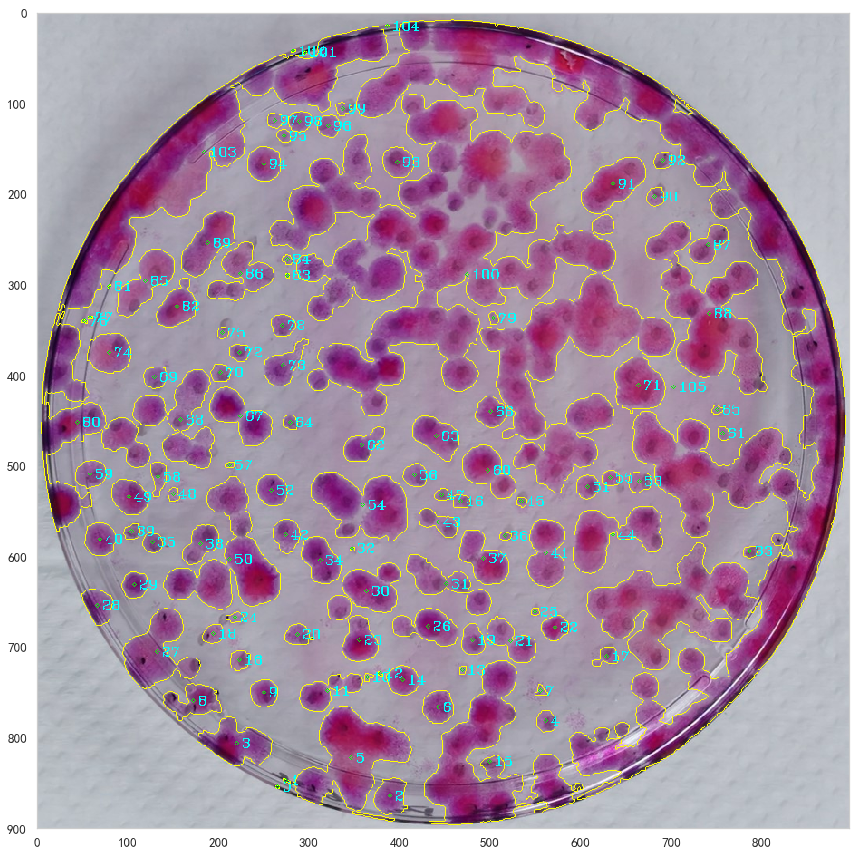

In [68]:
img_path = 'data/cells1/313-1.jpg'
hsv_filter = HsvFilter()
hsv_filter.process(img_path)
hsv_filter.draw_index()

In [69]:
# 轮廓分析
def cont_df_analysis(contours):
    
    print('轮廓总个数:', np.array(contours).shape[0])
    cont_arclength = []  # 轮廓周长
    hull = []  # 轮廓凸包
    hull_arclength = []  # 凸包周长
    cnt_boundingrect_w = []
    cnt_boundingrect_h = []
    for i in range(len(contours)):
        hull.append(cv2.convexHull(contours[i], True))  # 轮廓凸包
        cont_arclength.append(cv2.arcLength(contours[i], True))  # 轮廓周长
        hull_arclength.append(cv2.arcLength(hull[i], True))  # 轮廓凸包周长
        x,y, w, h = cv2.boundingRect(contours[i])
        cnt_boundingrect_w.append(w)
        cnt_boundingrect_h.append(h)
    cont_area = []
    hull_area = []
    for i in range(len(contours)):
        cont_area.append(cv2.contourArea(contours[i]))
        hull_area.append(cv2.contourArea(hull[i]))

    df_area = pd.DataFrame({
        'area': cont_area,
        'area_hull': hull_area,
        'arclength': cont_arclength,
        'arclength_hull': hull_arclength,
        'rect_w': cnt_boundingrect_w,
        'rect_h': cnt_boundingrect_h,
    })

    df_area['r1'] = df_area['area'] / df_area['arclength']  # 轮廓面积 / 轮廓周长 = 面积周长比
    df_area['r2'] = df_area['arclength'] / df_area['arclength_hull']
    df_area['r3'] = df_area['rect_w'] / df_area['rect_h']
    df_area['d1'] = df_area['area_hull'] - df_area['area']  # 凸包的面积 - 轮廓的面积
   
    return df_area

In [70]:
hsv_cnts = hsv_filter.cnts
df_area_filtered = cont_df_analysis(hsv_cnts)
# df_area_filtered.sort_values("r3")
df_area_filtered

轮廓总个数: 106


,area,area_hull,arclength,arclength_hull,rect_w,rect_h,r1,r2,r3,d1
0,11.5,11.5,13.414214,13.414214,5,4,0.857300,1.000000,1.250000,0.0
1,20.0,23.5,22.485281,21.476033,9,6,0.889471,1.046994,1.500000,3.5
2,1118.5,1244.0,142.325901,129.363932,38,42,7.858724,1.100198,0.904762,125.5
3,2598.0,3008.5,254.936073,211.607517,84,55,10.190790,1.204759,1.527273,410.5
4,401.5,414.5,76.526911,74.125801,22,25,5.246520,1.032392,0.880000,13.0
5,7738.5,11648.0,616.457932,408.506514,132,128,12.553168,1.509053,1.031250,3909.5
6,990.0,1016.5,120.083260,114.892545,35,37,8.244280,1.045179,0.945946,26.5
7,98.0,118.5,47.313708,43.499139,15,13,2.071281,1.087693,1.153846,20.5
8,1526.5,1940.5,225.580734,170.058670,65,42,6.766979,1.326488,1.547619,414.0
9,738.0,753.5,102.426406,98.603815,31,31,7.205173,1.038767,1.000000,15.5


In [71]:
df_area_filtered.describe()

,area,area_hull,arclength,arclength_hull,rect_w,rect_h,r1,r2,r3,d1
count,106.00000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000,106.000000
mean,3107.15566,6112.575472,264.032544,162.592323,50.764151,53.566038,6.392917,1.158137,1.078283,3005.419811
std,11500.51793,31287.785607,749.164894,270.445617,77.018681,99.972188,3.775176,0.322142,0.257215,20727.602234
min,9.00000,10.000000,12.828427,12.472136,4.000000,3.000000,0.701567,1.000000,0.461538,0.000000
25%,171.12500,182.500000,53.859650,51.316423,17.250000,15.250000,3.279792,1.038330,0.920667,10.000000
50%,648.75000,672.500000,101.183766,95.776180,30.500000,30.500000,6.241266,1.057506,1.045000,23.250000
75%,1637.75000,1893.625000,203.499259,168.097918,54.250000,52.750000,8.821310,1.128018,1.185497,216.250000
max,87240.50000,294092.000000,6056.787467,2198.038442,541.000000,861.000000,17.155109,3.459307,2.000000,206851.500000


### 定义类 分析颜色轮廓中群落的个数

In [72]:
class PopuCntAnalyser:
    """分析每个轮廓中一共有几个群落
    
    先画一些辅助图以bin_开头
    没有连接在一起的群落可以不用这个函数分析
    """
    def __init__(self, counters, img_src):
        self.cnts = counters  # 传进来所有的轮廓
        self.img = img_src
        self.total_popu = 0
        self.h, self.w, _ = img_src.shape

    def __getitem__(self, index):
        count = 0
#         img_draw = self.img.copy()  # 每次把轮廓画到不同的图上 test used
        img_draw = self.img  # 每次都把轮廓画到同一张图上
        # 1 首先直接画出 这个 轮廓
        cnt = self.cnts[index]  # 轮廓
        cv2.drawContours(img_draw, cnt, -1, (255, 255, 0), 1)  # 将轮廓cnt画到图img_draw上
        #print(cv2.contourArea(cnt))
        # -----------------------------------------------------------------
        #                                分析
        # -----------------------------------------------------------------
        cnt_area = cv2.contourArea(cnt)
        #print(cnt_area)
        if cnt_area < 800:  # 一个小的群落
            popu_num = 1 
        elif 1500 <= cnt_area <= 4000: # 分析连接在一起的轮廓中有几个群落  大轮廓 - 小轮廓 的图
            bin_sub_thresh = self._bin_count_with_hull(cnt)  
            popu_num = self.cont_popu_cnts(bin_sub_thresh)
            if popu_num == 0:  # 这个轮廓的计数凹轮廓为0 本身是一个大的圆润的轮廓
                popu_num += 1
        else:
            popu_num = self._bin_count_big_popu(cnt)
            #print(popu_num)
        # 4 把群落的个数写在轮廓旁边
        self.draw_number(img_draw, cnt, popu_num)
        # 5 累计所有的群落数
        self.total_popu += popu_num
        #single_popu_conts = cv2.drawContours(img_draw, popu_acount, -1, (255, 0, 0), 1)
        #self._draw_index(cnt, index)
        #plt_show(img_draw, figsize=(20, 15))
        
    def cont_popu_cnts(self, img_gray, min_area=8):
        """在生成轮廓的同时，过滤一些面积很小的轮廓
        args:
            img_gray:处理过的二值图像，包含用于计数的轮廓
        ret:
            good_cnts: 计数轮廓
        TODO：这个地方还可以做一些优化
        """
        good_cnts = []
        cnts, _ = cv2.findContours(img_gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        for cnt in cnts:
            area = cv2.contourArea(cnt)
            # print(area)
            if area > min_area:  # 对凹的计数轮廓的面积限定
                good_cnts.append(cnt)
        return len(good_cnts)
    
    def draw_count_cnts(self, img, cnts):
        """辅助函数：画出计数轮廓 用红色线"""
        cv2.drawContours(img, cnts, -1, (255, 0, 0), 1)
        
    def draw_number(self, img, cnt, string):
        """将轮廓中群落的个数 写在轮廓旁边"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(img, (cx, cy), 2, (0, 255, 0), cv2.FILLED)
        cv2.putText(img, str(string), (cx + 5, cy - 10),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0, 255, 255), 1)
        
    def draw_index(self, cnt, index):
        """辅助函数：画出轮廓的索引用于后续分析"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(self.img, (cx, cy), 2, (0, 255, 0), 1)
        cv2.putText(self.img, str(index), (cx + 5, cy + 5),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)
    
    def show_cnts(self):
        plt_show(self.img, figsize=(20, 15))

    def bin_contours(self, cnt):
        """在二值图上画出轮廓的填充图"""
        img_bin = np.zeros((self.h, self.w))
        draw_bin = cv2.drawContours(img_bin, [cnt], -1, [255, 255, 255], cv2.FILLED)
        return draw_bin
        
    def bin_enclose_circle(self, cnt):
        """在二值图上画出轮廓内接圆的填充图"""
        img_bin = np.zeros((self.h, self.w))
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        center = (int(x), int(y))
        radius = int(radius)
        draw_bin = cv2.circle(img_bin, center, radius, (255, 255, 255), cv2.FILLED)
        return draw_bin
    
    def bin_hull(self, cnt):
        """在二值图上画出轮廓凸包的填充图"""
        img_bin = np.zeros((self.h, self.w))
        hull = cv2.convexHull(cnt, False)
        res = cv2.drawContours(img_bin, [hull], -1, (255, 255, 255), cv2.FILLED)
        return res
    
    def _bin_count_with_circle(self, cnt):
        """使用轮廓外接圆减去轮廓后剩下的图形作为计数轮廓"""
        bin_circle = self.bin_enclose_circle(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_circle, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
  
        #print(type(bin_sub), bin_sub.shape, bin_sub)
        #plt_show(bin_circle, figsize=(20,15))
        #plt_show(bin_cnt, figsize=(20,15))
        #plt_show(bin_sub_thresh, figsize=(20,15))
        return bin_sub_thresh

    def _bin_count_with_hull(self, cnt):
        """使用轮廓外接凸包减去轮廓后剩下的图形作为计数轮廓
        inp：轮廓列表
        out: 凹轮廓二值图
        """
        bin_hull = self.bin_hull(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_hull, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)  # .astype(np.unit8) np数值类型转化
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
        
#         plt_show(bin_hull, figsize=(20,15))
#         plt_show(bin_cnt, figsize=(20,15))
#         plt_show(bin_sub_thresh, figsize=(20,15))
        return bin_sub_thresh  

    def _bin_count_big_popu(self, cnt):
        """这里首要考虑的事情是腐蚀轮廓拉开连在一起的群落"""
        accumulate_popu_num = 0
        bin_cnt = self.bin_contours(cnt)
        #plt_show(bin_cnt, figsize=(20,15))
        
        kernel = np.ones((3, 3), np.uint8)
        bin_cnt_erode = cv2.erode(bin_cnt, kernel, iterations=4)
        #plt_show(bin_cnt_erode, figsize=(20,15))
        
        bin_cnt_erode = bin_cnt_erode.astype(np.uint8)
#         _, bin_cnt_erode_thresh = cv2.threshold(bin_cnt_erode, 50, 255, cv2.THRESH_BINARY)
#         plt_show(bin_cnt_erode_thresh, figsize=(20,15))
        
#         bin_cnt_erode = bin_cnt_erode.astype(np.uint8)
        cnts, _ = cv2.findContours(bin_cnt_erode, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        #print("轮廓个数：", len(cnts))
        for cnt in cnts:
            cnt_area = cv2.contourArea(cnt)
            #print(cnt_area)
            if cnt_area > 6000:  # 如果腐蚀之后轮廓还是很大就直接用面积近似计算
                popu_num = math.ceil(cnt_area / 1200)
                # TODO：面积处理  是不是要做递归处理？
                accumulate_popu_num += popu_num
            else:  # 仍然使用凹轮廓计数
                img_bin = self._bin_count_with_hull(cnt)
                #plt_show(img_bin,  figsize=(20,15))
                popu_num = self.cont_popu_cnts(img_bin)
                if popu_num == 0:  # 一个很圆润的轮廓可能没有 凹的计数轮廓
                    popu_num += 1
                accumulate_popu_num += popu_num
        #kernel = np.ones((3,3),np.uint8) 
        #bin_cnt_opening = cv2.morphologyEx(bin_cnt_erode, cv2.MORPH_OPEN, kernel)
        
        #plt_show(bin_cnt_erode_thresh, figsize=(20,15))
        #plt_show(bin_cnt, figsize=(20,15))
        #plt_show(bin_sub_thresh, figsize=(20,15))
        #print('大轮廓中群落的个数为', accumulate_popu_num)
        return accumulate_popu_num
        

In [198]:
hsv_cnts, processed_img = hsv_filter.cnts, hsv_filter.resized_img
popu_analyser = PopuCntAnalyser(hsv_cnts, processed_img)

In [200]:
for idx in range(len(hsv_cnts)):
    popu_analyser[idx]

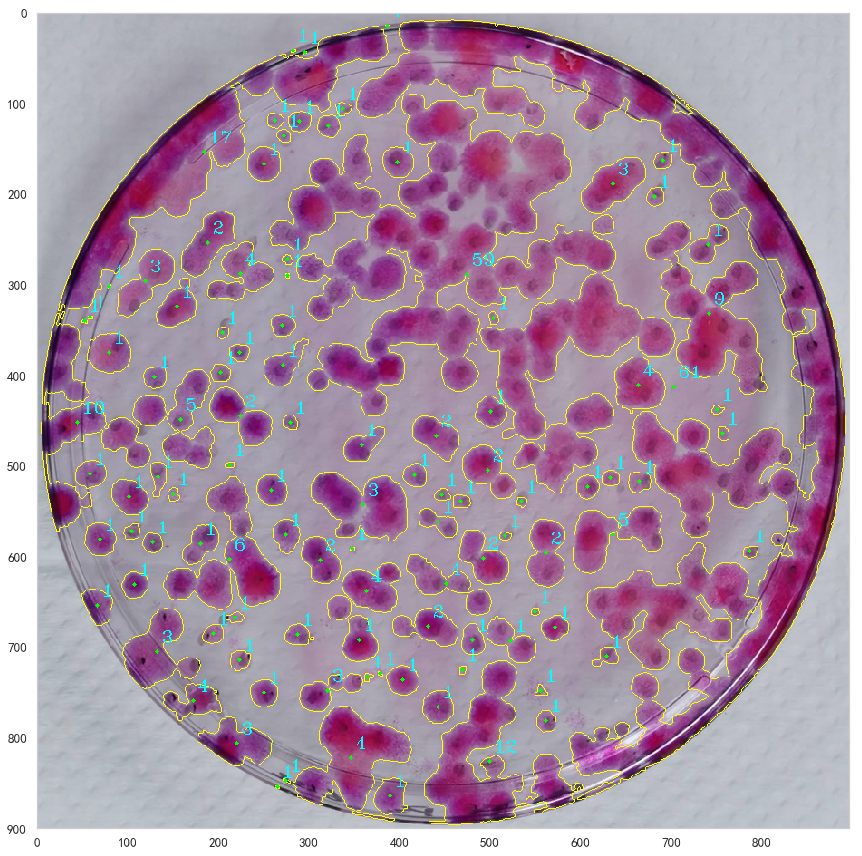

In [201]:
popu_analyser.show_cnts()

In [202]:
popu_analyser.total_popu

319

In [74]:
def cell_population_count(img_path):
    hsv_filter = HsvFilter()
    hsv_filter.process(img_path)
    hsv_cnts, processed_img = hsv_filter.cnts, hsv_filter.resized_img
    popu_analyser = PopuCntAnalyser(hsv_cnts, processed_img)
    for idx in range(len(hsv_cnts)):
        popu_analyser[idx]
    popu_analyser.show_cnts()
    print(popu_analyser.total_popu)

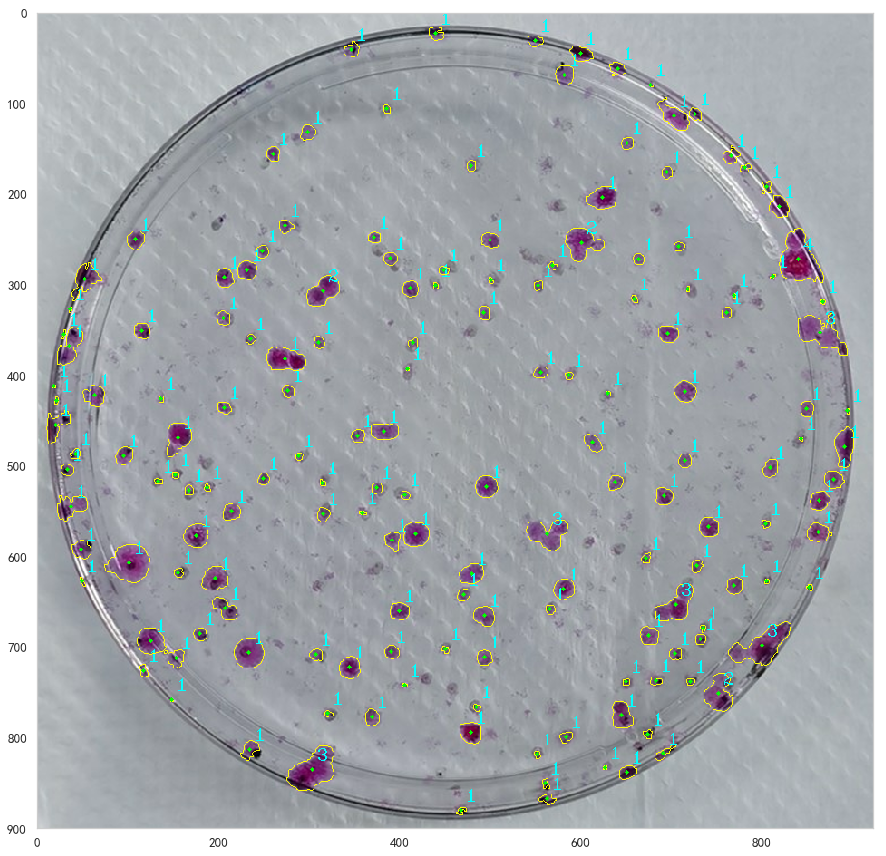

179


In [75]:
img_path = 'data/cells1/187-1.jpg'
cell_population_count(img_path)

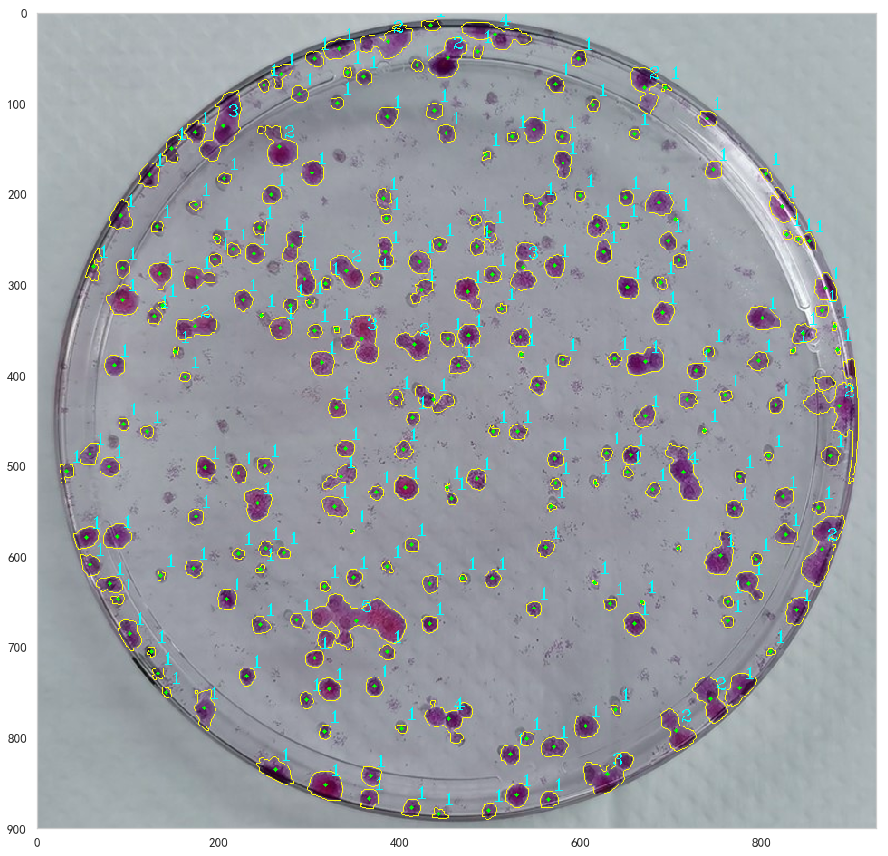

273


In [76]:
img_path = 'data/cells1/296-1.jpg'
cell_population_count(img_path)

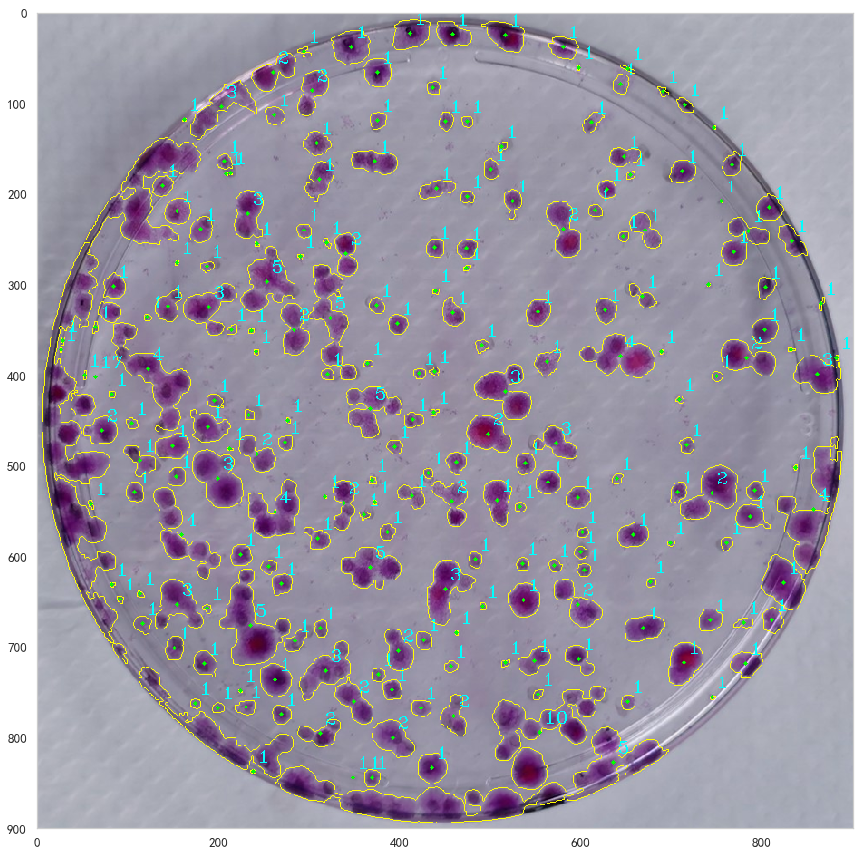

330


In [77]:
img_path = 'data/cells1/308-1.jpg'
cell_population_count(img_path)

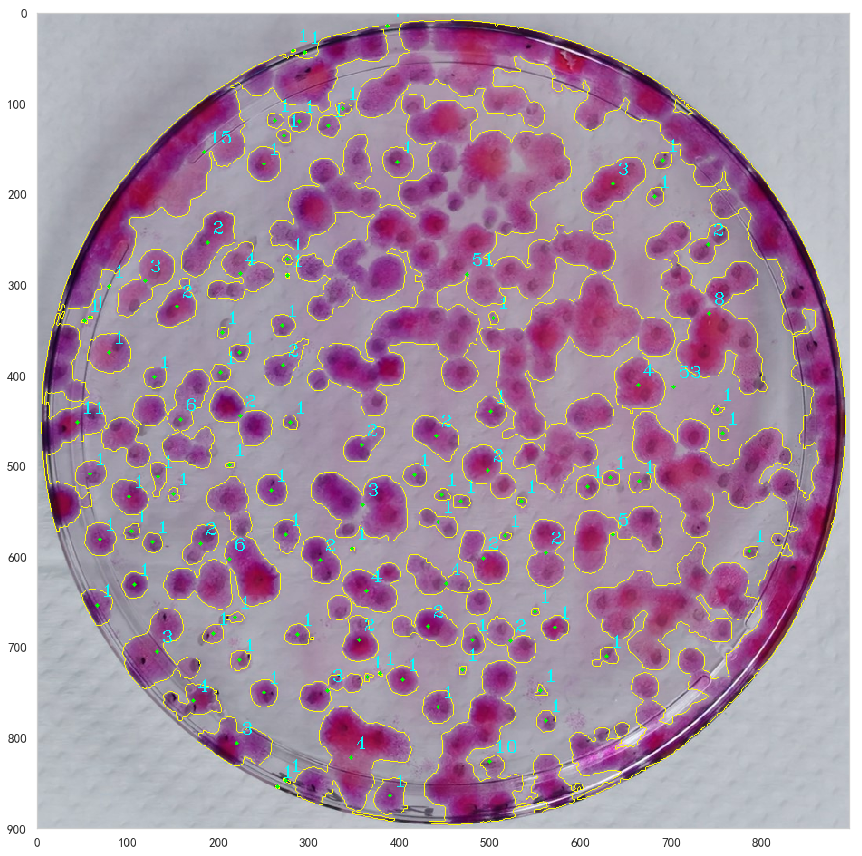

307


In [78]:
img_path = 'data/cells1/313-1.jpg'
cell_population_count(img_path)

## 代码重构 软件编写

In [ ]:
class HsvFilter:
    """从原始图片经过HSV颜色分割拿到合适的轮廓
    inp: img path
    out: contours of cell populations and resized img
    1) 读入图片
    2）缩放
    3）hsv滤波
    4）初步筛选轮廓
    5）保存处理后的轮廓和图形
    """

    def __init__(self):
        self.img = None
        self.resized_img = None
        self.cnts = None

    def process(self, img):
        # 1 读入图片
        # self.img = cv2.imread(img_path)
        self.img = img
        # 2 将图片大小等比缩放到h=900, w=900*scale
        self.resized_img = self.resize(self.img)
        # 3 颜色分割
        mask = self._hsv_creterions(self.resized_img)
        # 4 拿到轮廓
        contours, hierarchy = cv2.findContours(mask,
                                               cv2.RETR_EXTERNAL,
                                               cv2.CHAIN_APPROX_NONE)
        # 5 初步过滤掉一些轮廓
        self.cnts = self._fileter_cnts(contours)

    def _hsv_creterions(self, img, low=[130, 50, 50], up=[200, 250, 200]):
        """这里返回的轮廓是后续群落计数的基础
        直接返回过滤后的全图轮廓
        """
        # 1 颜色转换
        img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        # 2 阈值过滤
        low_purple = np.array(low)
        high_purple = np.array(up)
        mask = cv2.inRange(img_hsv, low_purple, high_purple)

        # 3 膨胀处理二值轮廓掩膜  这一步的处理 抑制了培养皿边缘的噪音
        kernel = np.ones((3, 3), np.uint8)
        mask_dilate = cv2.dilate(mask, kernel, iterations=1)
        # 4 返回过滤后的二值轮廓图像
        return mask_dilate

    def resize(self, img, fixed_size=900):
        h, w, _ = img.shape
        nh, nw = fixed_size, int(fixed_size * (w / h))
        img_resize = cv2.resize(img, (nw, nh), interpolation=cv2.INTER_CUBIC)
        return img_resize

    def _fileter_cnts(self, contours, min_area=8):
        """初步过滤掉一些轮廓
        这里可以进一步添加规则 得到较优质的轮廓
        """
        filtered_cnts = []
        for cnt in contours:
            cnt_area = cv2.contourArea(cnt)
            # cnt_length =  cv2.arcLength(cnt,True)
            # area_length_ratio = cnt_area / cnt_length
            # 所有的轮廓都经过了一次膨胀处理，这里的轮廓面积选择条件要考虑到这一点
            # if cnt_area > min_area and area_length_ratio > 0.5:
            if cnt_area > min_area:
                x, y, w, h = cv2.boundingRect(cnt)
                if 0.25 < w / h < 4:  # 不要很扁的也不要很高的轮廓
                    filtered_cnts.append(cnt)
        return filtered_cnts

    def draw_index(self):
        """画出轮廓的索引便于逐个分析轮廓"""
        img_draw = self.resized_img.copy()
        for idx, cnt in enumerate(self.cnts):  # 这里索引的顺序是self.cnts的顺序

            cv2.drawContours(img_draw, cnt, -1, (255, 255, 0), 1)

            M = cv2.moments(cnt)
            cx = int(M['m10'] / M['m00'])
            cy = int(M['m01'] / M['m00'])
            cv2.circle(img_draw, (cx, cy), 2, (0, 255, 0), 1)
            cv2.putText(img_draw, str(idx), (cx + 5, cy + 5),
                        cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)


class PopuCntAnalyser:
    """分析每个轮廓中一共有几个群落

    先画一些辅助图以bin_开头
    没有连接在一起的群落可以不用这个函数分析
    """

    def __init__(self, counters, img_src):
        self.cnts = counters  # 传进来所有的轮廓
        self.img = img_src
        self.total_popu = 0
        self.h, self.w, _ = img_src.shape

    def __getitem__(self, index):
        img_draw = self.img  # 每次都把轮廓画到同一张图上
        # 1 首先直接画出 这个 轮廓
        cnt = self.cnts[index]  # 轮廓
        cv2.drawContours(img_draw, cnt, -1, (255, 255, 0), 1)  # 将轮廓cnt画到图img_draw上
        cnt_area = cv2.contourArea(cnt)
        # print(cnt_area)
        if cnt_area < 800:  # 一个小的群落
            popu_num = 1
        elif 1500 <= cnt_area <= 4000:  # 分析连接在一起的轮廓中有几个群落  大轮廓 - 小轮廓 的图
            bin_sub_thresh = self._bin_count_with_hull(cnt)
            popu_num = self.cont_popu_cnts(bin_sub_thresh)
            if popu_num == 0:  # 这个轮廓的计数凹轮廓为0 本身是一个大的圆润的轮廓
                popu_num += 1
        else:
            popu_num = self._bin_count_big_popu(cnt)
        # 4 把群落的个数写在轮廓旁边
        self.draw_number(img_draw, cnt, popu_num)
        # 5 累计所有的群落数
        self.total_popu += popu_num
        # single_popu_conts = cv2.drawContours(img_draw, popu_acount, -1, (255, 0, 0), 1)
        # self._draw_index(cnt, index)
        # plt_show(img_draw, figsize=(20, 15))

    def cont_popu_cnts(self, img_gray, min_area=8):
        """在生成轮廓的同时，过滤一些面积很小的轮廓
        args:
            img_gray:处理过的二值图像，包含用于计数的轮廓
        ret:
            good_cnts: 计数轮廓
        TODO：这个地方还可以做一些优化
        """
        good_cnts = []
        cnts, _ = cv2.findContours(img_gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        for cnt in cnts:
            area = cv2.contourArea(cnt)
            # print(area)
            if area > min_area:  # 对凹的计数轮廓的面积限定
                good_cnts.append(cnt)
        return len(good_cnts)

    def draw_count_cnts(self, img, cnts):
        """辅助函数：画出计数轮廓 用红色线"""
        cv2.drawContours(img, cnts, -1, (255, 0, 0), 1)

    def draw_number(self, img, cnt, string):
        """将轮廓中群落的个数 写在轮廓旁边"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(img, (cx, cy), 2, (0, 255, 0), cv2.FILLED)
        cv2.putText(img, str(string), (cx + 5, cy - 10),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0, 255, 255), 1)

    def draw_index(self, cnt, index):
        """辅助函数：画出轮廓的索引用于后续分析"""
        M = cv2.moments(cnt)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])
        cv2.circle(self.img, (cx, cy), 2, (0, 255, 0), 1)
        cv2.putText(self.img, str(index), (cx + 5, cy + 5),
                    cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.8, (0, 255, 255), 1)

    def bin_contours(self, cnt):
        """在二值图上画出轮廓的填充图"""
        img_bin = np.zeros((self.h, self.w))
        draw_bin = cv2.drawContours(img_bin, [cnt], -1, [255, 255, 255], cv2.FILLED)
        return draw_bin

    def bin_enclose_circle(self, cnt):
        """在二值图上画出轮廓内接圆的填充图"""
        img_bin = np.zeros((self.h, self.w))
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        center = (int(x), int(y))
        radius = int(radius)
        draw_bin = cv2.circle(img_bin, center, radius, (255, 255, 255), cv2.FILLED)
        return draw_bin

    def bin_hull(self, cnt):
        """在二值图上画出轮廓凸包的填充图"""
        img_bin = np.zeros((self.h, self.w))
        hull = cv2.convexHull(cnt, False)
        res = cv2.drawContours(img_bin, [hull], -1, (255, 255, 255), cv2.FILLED)
        return res

    def _bin_count_with_circle(self, cnt):
        """使用轮廓外接圆减去轮廓后剩下的图形作为计数轮廓"""
        bin_circle = self.bin_enclose_circle(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_circle, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)

        return bin_sub_thresh

    def _bin_count_with_hull(self, cnt):
        """使用轮廓外接凸包减去轮廓后剩下的图形作为计数轮廓
        inp：轮廓列表
        out: 凹轮廓二值图
        """
        bin_hull = self.bin_hull(cnt)
        bin_cnt = self.bin_contours(cnt)
        bin_sub = cv2.subtract(bin_hull, bin_cnt)
        bin_sub = bin_sub.astype(np.uint8)  # .astype(np.unit8) np数值类型转化
        _, bin_sub_thresh = cv2.threshold(bin_sub, 50, 255, cv2.THRESH_BINARY)
        return bin_sub_thresh

    def _bin_count_big_popu(self, cnt):
        """这里首要考虑的事情是腐蚀轮廓拉开连在一起的群落"""
        accumulate_popu_num = 0
        bin_cnt = self.bin_contours(cnt)

        kernel = np.ones((3, 3), np.uint8)
        bin_cnt_erode = cv2.erode(bin_cnt, kernel, iterations=4)

        bin_cnt_erode = bin_cnt_erode.astype(np.uint8)
        cnts, _ = cv2.findContours(bin_cnt_erode, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        for cnt in cnts:
            cnt_area = cv2.contourArea(cnt)
            if cnt_area > 6000:  # 如果腐蚀之后轮廓还是很大就直接用面积近似计算
                popu_num = math.ceil(cnt_area / 1200)
                # TODO：面积处理  是不是要做递归处理？
                accumulate_popu_num += popu_num
            else:  # 仍然使用凹轮廓计数
                img_bin = self._bin_count_with_hull(cnt)
                popu_num = self.cont_popu_cnts(img_bin)
                if popu_num == 0:  # 一个很圆润的轮廓可能没有 凹的计数轮廓
                    popu_num += 1
                accumulate_popu_num += popu_num
        return accumulate_popu_num


def cell_population_count(img_rgb):
    """编写细胞群落计数接口
    inp: RGB图片，
    out: 标记后的图和细胞数"""
    hsv_filter = HsvFilter()
    hsv_filter.process(img_rgb)
    hsv_cnts, processed_img = hsv_filter.cnts, hsv_filter.resized_img
    popu_analyser = PopuCntAnalyser(hsv_cnts, processed_img)
    for idx in range(len(hsv_cnts)):
        popu_analyser[idx]
    return popu_analyser.total_popu, popu_analyser.img